In [1]:
import multiprocessing
from sklearn.cluster import KMeans
import pandas as pd
import numpy as np
import seaborn as sns
import scipy.stats as stats
import matplotlib.pyplot as plt

import tensorflow as tf

import sys
sys.path.append("/Users/achakrab/Desktop/ecrp/githubcode")
import pathsig

import torch
import signatory

import nnmodule

from scipy.spatial.distance import euclidean
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.stattools import acf
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredError
from tensorflow import gather


from scipy.signal import welch
import torch.optim as optim
from torch import nn
import torch.nn.functional as F

from sklearn.model_selection import KFold
import math
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import rpy2.robjects as robjects
from rpy2.robjects import r
from rpy2.robjects import pandas2ri
from pykrige.ok import OrdinaryKriging
from scipy.interpolate import griddata
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io.shapereader import natural_earth, Reader
import itertools
from matplotlib.lines import Line2D
import statsmodels.api as sm
from scipy.spatial.distance import pdist
from scipy.spatial.distance import squareform


multiprocessing.cpu_count()


12

# Read NWP model outputs

In [4]:
file_path='/Users/achakrab/Desktop/ecrp/greatlakesregion/Long_C2_FR.RData'
r['load'](file_path)

pandas2ri.activate()
nwp_long_fine = robjects.conversion.rpy2py(r['Long_C2_FR'])

print(f'Longitude shape: {nwp_long_fine.shape}')

file_path='/Users/achakrab/Desktop/ecrp/greatlakesregion/Lat_C2_FR.RData'
r['load'](file_path)

pandas2ri.activate()
nwp_lat_fine = robjects.conversion.rpy2py(r['Lat_C2_FR'])

print(f'Latitude shape: {nwp_lat_fine.shape}')

file_path = '/Users/achakrab/Desktop/ecrp/greatlakesregion/ws.nwp.JAN12.C2grid.FiRes.RData'
r['load'](file_path)

pandas2ri.activate()
nwp_jan12_fine = robjects.conversion.rpy2py(r['ws.nwp.JAN12.C2grid'])
nwp_jan12_fine= nwp_jan12_fine[:,:,24:]
print(f'Spatio temporal NWP data: {nwp_jan12_fine.shape}')


Longitude shape: (49, 68)
Latitude shape: (49, 68)
Spatio temporal NWP data: (49, 68, 695)


In [6]:
#(time*space)
k1 = nwp_jan12_fine.shape[0]  
k2 = nwp_jan12_fine.shape[1] 
kT = nwp_jan12_fine.shape[2]  
fine_nwp_JAN12 = np.zeros((k1 * k2,kT))

# Populate the new 2D array
for t in range(kT):
   fine_nwp_JAN12[:,t] = nwp_jan12_fine[:, :, t].T.flatten()

# Check the shape of the new array
print(f'spatio temporal data shape: {fine_nwp_JAN12.shape}')

hours=15
length = (fine_nwp_JAN12.shape[1]// hours)
print("Number of iid samples")
print(length) #59
remainder = fine_nwp_JAN12.shape[1] % hours
print("number of samples to discard in each location")
print(remainder) #11
# Handle if there is remainder (missing data)
if remainder > 0:
    # Trim the data if there's leftover and we want only full samples
    flattened_trimmed_nwp = fine_nwp_JAN12[:,:-remainder]
else:
    flattened_trimmed_nwp = flattened
print(f"Final time*space input shape: {flattened_trimmed_nwp.shape}")

reshaped_array =flattened_trimmed_nwp.T.reshape(length, hours, flattened_trimmed_nwp.shape[0])
nwp_tensor = torch.tensor(reshaped_array, dtype=torch.float32)

# Output tensor shape
print(f'NWP tensor: {nwp_tensor.shape}')


spatio temporal data shape: (3332, 695)
Number of iid samples
46
number of samples to discard in each location
5
Final time*space input shape: (3332, 690)
NWP tensor: torch.Size([46, 15, 3332])


In [8]:
#Flatten lat and lon
lat_flat = nwp_lat_fine.T.flatten()  # Shape (3332,)
long_flat = nwp_long_fine.T.flatten()  # Shape (3332,)

# Check shapes
print(f"Lat shape: {lat_flat.shape}")
print(f"Lon shape: {long_flat.shape}")

# Repeat lat and lon to match the number of time steps and hours
lat_repeated = np.tile(lat_flat, (length, hours, 1))  # Shape (length, hours, 3332)
lon_repeated = np.tile(long_flat, (length, hours, 1))  # Shape (length, hours, 3332)

#Convert to PyTorch tensors
lat_tensor = torch.tensor(lat_repeated, dtype=torch.float32)
lon_tensor = torch.tensor(lon_repeated, dtype=torch.float32)


Lat shape: (3332,)
Lon shape: (3332,)


# Read ASOS Observations

In [11]:
file_path = '/Users/achakrab/Desktop/ecrp/greatlakesregion/wd.obs1.JAN12.RData'
r['load'](file_path)

obs_jan12 = robjects.conversion.rpy2py(r['wd.obs.JAN12'])
print(f"Total observation stations: {obs_jan12.shape}")

subregobs2 = [26,18,8,22,14,31,13,20,11,23,29,2]
y=[x - 1 for x in subregobs2]
obs_jan12_subreg2=obs_jan12[:,y]
print(f"Cluster 2 observation stations: {obs_jan12_subreg2.shape}")

length = (obs_jan12_subreg2.shape[0]// hours)
print(f"Number of iid samples: {length}")
remainder = obs_jan12_subreg2.shape[0] % hours
print(f"number of samples to discard in each location: {remainder}")

# Handle if there is remainder (missing data)
if remainder > 0:
    # Trim the data if there's leftover and we want only full samples
    flattened_trimmed_obs = obs_jan12_subreg2[:-remainder,:]
else:
    flattened_trimmed_obs = flattened

print(f'Obs trimmed data: {flattened_trimmed_obs.shape}')
reshaped_array =flattened_trimmed_obs.reshape(length, hours, len(subregobs2))
obs_tensor = torch.tensor(reshaped_array, dtype=torch.float32)
print(f'Obs tensor: {obs_tensor.shape}') #last index is location 

lat_obs=[44.63806 ,44.35917, 43.76944, 43.15611, 43.21194, 43.76944, 42.76111, 42.59500, 42.41667, 41.77000, 42.12083, 41.61389]
lon_obs=[-90.18750, -89.83694, -88.49083, -90.67750, -90.18139, -87.85056, -87.81361,-87.93806, -87.86667, -88.48139, -87.90472, -90.59139]

# Check shapes
print(f"Lat/lon length: {len(lat_obs)}")

# Repeat lat and lon to match the number of time steps and hours
lat_repeated = np.tile(lat_obs, (length, hours, 1))  # Shape (length, hours, 3332)
lon_repeated = np.tile(lon_obs, (length, hours, 1))  # Shape (length, hours, 3332)

#Convert to PyTorch tensors
lat_tensor = torch.tensor(lat_repeated, dtype=torch.float32)
lon_tensor = torch.tensor(lon_repeated, dtype=torch.float32)
print(f'Lat tensor: {lat_tensor.shape}')

# Now concatenate lat and lon with the nwp_tensor
# nwp_tensor is of shape (length, hours, 3332)
# We want to concatenate along the last dimension (i.e., the "space" dimension)
augmentedobs_tensor = torch.cat((obs_tensor, lat_tensor, lon_tensor), dim=2)

# Output shape
print(f'Lat long augmented with obs: {augmentedobs_tensor.shape}')

Total observation stations: (695, 31)
Cluster 2 observation stations: (695, 12)
Number of iid samples: 46
number of samples to discard in each location: 5
Obs trimmed data: (690, 12)
Obs tensor: torch.Size([46, 15, 12])
Lat/lon length: 12
Lat tensor: torch.Size([46, 15, 12])
Lat long augmented with obs: torch.Size([46, 15, 36])


NWP DATA : (3332, 690)
ASOS data: (690, 12)


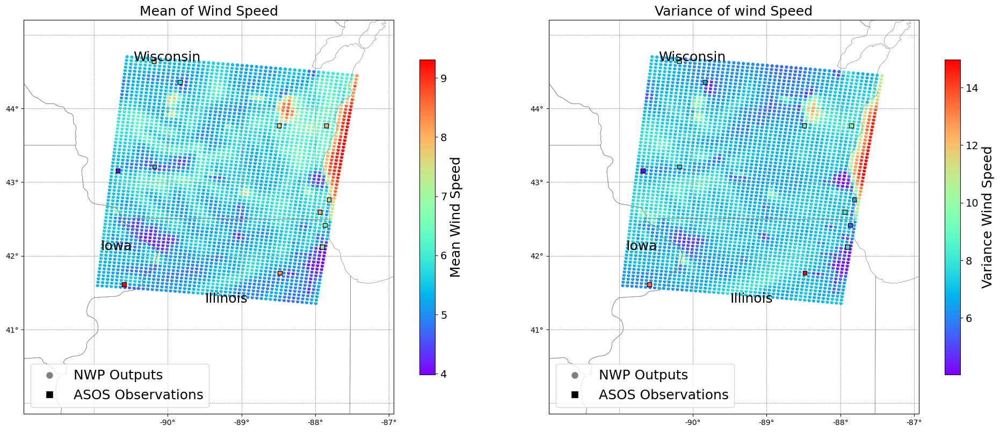

In [13]:
any_in_lat = any(value in nwp_long_fine for value in lon_obs)

sorted_array = np.sort(nwp_lat_fine, axis=None)

lon_min=nwp_long_fine.min()
lon_max=nwp_long_fine.max()
lat_min=nwp_lat_fine.min()
lat_max=nwp_lat_fine.max()

print(f'NWP DATA : {flattened_trimmed_nwp.shape}')
print(f'ASOS data: {flattened_trimmed_obs.shape}')

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.var(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(flattened_trimmed_obs, axis=0)
variance_values_obs = np.var(flattened_trimmed_obs, axis=0)

# Set up side-by-side plots
fig, ax = plt.subplots(1, 2, figsize=(20, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Function to add features to both subplots
def add_map_features(ax, title):
    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=1, edgecolor='black')
    ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5)

    # Highlight the rectangular grid area
    # ax.plot([lon_min, lon_max, lon_max, lon_min, lon_min],
    #         [lat_min, lat_min, lat_max, lat_max, lat_min],
    #         color='red', linewidth=2, transform=ccrs.PlateCarree(), label='Region of Interest')

    # Add state names
    states_shapefile = natural_earth(resolution='10m', category='cultural', name='admin_1_states_provinces_lakes')
    reader = Reader(states_shapefile)
    for record in reader.records():
        if record.attributes['admin'] == 'United States of America':  # Select U.S. states
            state_name = record.attributes['name']
            lon, lat = record.geometry.centroid.coords[0]
            if lon_min-1 <= lon <= lon_max and lat_min <= lat <= lat_max:
                ax.text(lon, lat, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            if lon_min-1 <= lon <= lon_max and lat_min <= lat+1.3 <= lat_max:
                ax.text(lon, lat+1.3, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            if lon_min <= lon+2.8 <= lon_max and lat_min <= lat <= lat_max:
                ax.text(lon+2.8, lat, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            

    # **Zoom in exactly to the bounding box**
    ax.set_extent([lon_min-1, lon_max+0.5, lat_min-1.5, lat_max+0.5], crs=ccrs.PlateCarree())

    # Customize axes
    ax.set_xticks(range(int(lon_min), int(lon_max) +1), crs=ccrs.PlateCarree())
    ax.set_yticks(range(int(lat_min), int(lat_max) + 1), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{x}°"))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f"{y}°"))
    
    # Gridlines
    ax.gridlines(draw_labels=False, linewidth=0.5, color='gray', linestyle='--')

    # Set title
    ax.set_title(title, fontsize=18)

# Plot Mean Temperature
sc1 = ax[0].scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', edgecolors='white', s=30, transform=ccrs.PlateCarree())
obs_sc1 = ax[0].scatter(lon_obs, lat_obs, c=mean_values_obs, cmap='rainbow', edgecolors='black', marker='s', s=30, transform=ccrs.PlateCarree())

add_map_features(ax[0], "Mean of Wind Speed")

# Add colorbar
cbar1 = plt.colorbar(sc1, ax=ax[0], orientation='vertical', shrink=0.8)
cbar1.set_label("Mean Wind Speed", fontsize=18)
cbar1.ax.tick_params(labelsize=14)

# Add legend manually
ax[0].legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markersize=10, markerfacecolor='gray', label='NWP Outputs'),
                      plt.Line2D([0], [0], marker='s', color='w', markersize=10, markerfacecolor='black', label='ASOS Observations')],
             loc="lower left", fontsize=18)

# Plot Variance Temperature
sc2 = ax[1].scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow', edgecolors='white', s=30, transform=ccrs.PlateCarree())
obs_sc2 = ax[1].scatter(lon_obs, lat_obs, c=variance_values_obs, cmap='rainbow', edgecolors='black', marker='s', s=30, transform=ccrs.PlateCarree())

add_map_features(ax[1], "Variance of wind Speed")

# Add colorbar
cbar2 = plt.colorbar(sc2, ax=ax[1], orientation='vertical', shrink=0.8)
cbar2.set_label("Variance Wind Speed", fontsize=18)
cbar2.ax.tick_params(labelsize=14)

# Add legend manually
ax[1].legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markersize=10, markerfacecolor='gray', label='NWP Outputs'),
                      plt.Line2D([0], [0], marker='s', color='w', markersize=10, markerfacecolor='black', label='ASOS Observations')],
             loc="lower left", fontsize=18)

# Show plot
plt.tight_layout()
plt.show()


(3332, 690)
(690, 12)


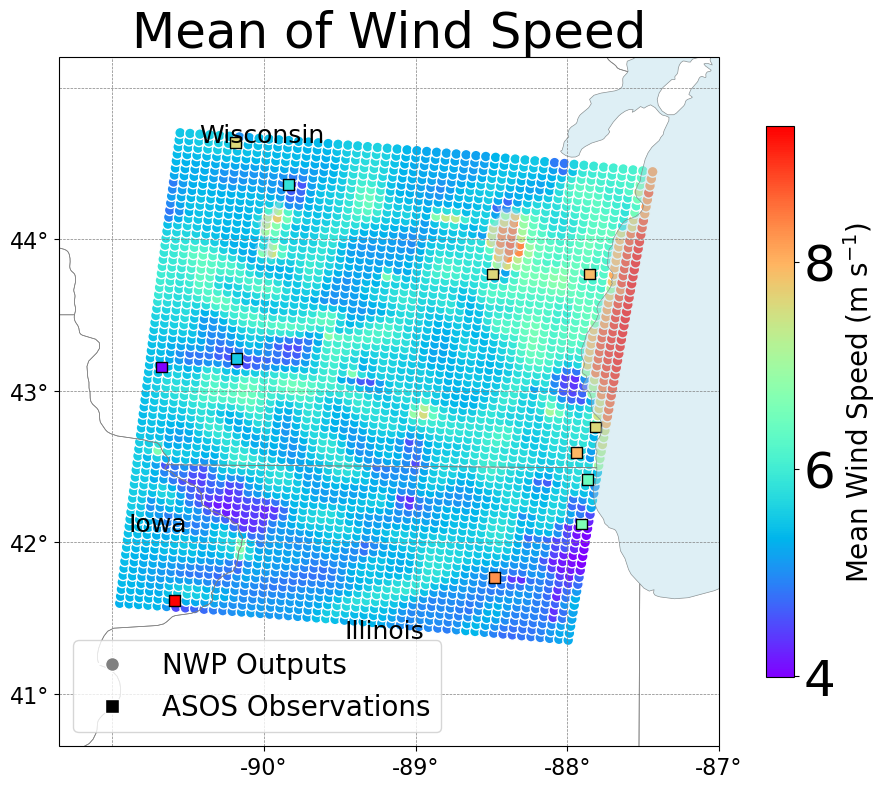

In [14]:
print(flattened_trimmed_nwp.shape)
print(flattened_trimmed_obs.shape)

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.var(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(flattened_trimmed_obs, axis=0)
variance_values_obs = np.var(flattened_trimmed_obs, axis=0)

# Set up side-by-side plots
fig, ax = plt.subplots(1, 1, figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Function to add features to both subplots
def add_map_features(ax, title):
    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=1, edgecolor='black')
    ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5)
    ax.add_feature(cfeature.LAKES, facecolor='lightblue', alpha=0.4)  # Lakes with transparency


    # Highlight the rectangular grid area
    # ax.plot([lon_min, lon_max, lon_max, lon_min, lon_min],
    #         [lat_min, lat_min, lat_max, lat_max, lat_min],
    #         color='red', linewidth=2, transform=ccrs.PlateCarree(), label='Region of Interest')

    # Add state names
    states_shapefile = natural_earth(resolution='10m', category='cultural', name='admin_1_states_provinces_lakes')
    reader = Reader(states_shapefile)
    for record in reader.records():
        if record.attributes['admin'] == 'United States of America':  # Select U.S. states
            state_name = record.attributes['name']
            lon, lat = record.geometry.centroid.coords[0]
            if lon_min-1 <= lon <= lon_max and lat_min <= lat <= lat_max:
                ax.text(lon, lat, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            if lon_min-1 <= lon <= lon_max and lat_min <= lat+1.3 <= lat_max:
                ax.text(lon, lat+1.3, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            if lon_min <= lon+2.8 <= lon_max and lat_min <= lat <= lat_max:
                ax.text(lon+2.8, lat, state_name, fontsize=18, ha='center', transform=ccrs.PlateCarree())
            

    # **Zoom in exactly to the bounding box**
    ax.set_extent([lon_min-0.4, lon_max, lat_min-0.7, lat_max+0.5], crs=ccrs.PlateCarree())

    # Customize axes
    ax.set_xticks(range(int(lon_min), int(lon_max) +1), crs=ccrs.PlateCarree())
    ax.set_yticks(range(int(lat_min), int(lat_max) + 1), crs=ccrs.PlateCarree())
    # Customize tick labels' font size
    for tick in ax.get_xticklabels():
        tick.set_fontsize(16)
    for tick in ax.get_yticklabels():
        tick.set_fontsize(16)
        
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{x}°"))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f"{y}°"))
    
    # Gridlines
    ax.gridlines(draw_labels=False, linewidth=0.5, color='gray', linestyle='--')

    # Set title
    ax.set_title(title, fontsize=36)

# Plot Mean Temperature
sc1 = ax.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', edgecolors='white', s=60, transform=ccrs.PlateCarree())
obs_sc1 = ax.scatter(lon_obs, lat_obs, c=mean_values_obs, cmap='rainbow', edgecolors='black', marker='s', s=60, transform=ccrs.PlateCarree())

add_map_features(ax, "Mean of Wind Speed")

# Add colorbar
cbar1 = plt.colorbar(sc1, ax=ax, orientation='vertical', shrink=0.8)
cbar1.set_label("Mean Wind Speed (m s$^{-1}$)", fontsize=20)
cbar1.ax.tick_params(labelsize=36)

# Add legend manually
ax.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markersize=10, markerfacecolor='gray', label='NWP Outputs'),
                      plt.Line2D([0], [0], marker='s', color='w', markersize=10, markerfacecolor='black', label='ASOS Observations')],
             loc="lower left", fontsize=20)



# Show plot
plt.tight_layout()
plt.savefig('nwpmean.pdf')
plt.show()


# Evaluate the path signatures

In [16]:
print(f"Original data shape: {nwp_tensor.shape}")
add_time = pathsig.AddTime()
append_zero=pathsig.AppendZero()
transformed_ts = add_time.fit_transform(nwp_tensor)
print(f"After adding time as another channel: {transformed_ts.shape}")
final_transformed_ts= append_zero.transform(transformed_ts)
print(f"Augmenting with 0 in time: {final_transformed_ts.shape}")

Original data shape: torch.Size([46, 15, 3332])
After adding time as another channel: torch.Size([46, 15, 3333])
Augmenting with 0 in time: torch.Size([46, 16, 3333])


In [17]:
compute_signature = pathsig.ComputeWindowSignature(
    window_name='Dyadic',          # The windowing method to use
    window_kwargs={'depth': 2},    # Parameters for the windowing method
    ds_length=final_transformed_ts.shape[1] ,                 # Length of the dataset
    sig_tfm='signature',           # Use signature transformation
    depth=1,                       # Signature depth
    rescaling=None,                # Rescaling method
    normalisation=None             # Normalisation method
)

#see the windows in detail
dyadic_window_instance = pathsig.window_getter('Dyadic', depth=2)
length =final_transformed_ts.shape[1] 
windows =dyadic_window_instance(length)
print(windows)
numwin= compute_signature.num_windows(final_transformed_ts.shape[1])
print(f"Total windows : {numwin}")

# Prepare the input path tensor
path = final_transformed_ts
signatures = compute_signature.forward(path)

# Print the signatures
print(f"Total signatures: len(signatures) ")

flattened_signatures = [signature for group in signatures for signature in group]
print(len(flattened_signatures))
# this is a list of length 7 corresponding to 7 windows,
#each element in the list has signature shape [46,3333]

stacked_signatures = torch.cat(flattened_signatures, dim=1)
print(stacked_signatures.shape)# concatenating all 7 signatures for all windows, first global, then half, then ...

smodule=signatory.signature_module
# Convert PyTorch tensor to NumPy for use with scikit-learn
flattened_signatures = [signature for group in signatures for signature in group]
columnwise_signatures = torch.cat(flattened_signatures, dim=1)
columnwise_signatures_np = columnwise_signatures.detach().cpu().numpy()
print(f'columnwise signatures: {columnwise_signatures_np.shape}')


[[Pair(start=0, end=16)], [Pair(start=0, end=8), Pair(start=8, end=16)], [Pair(start=0, end=4), Pair(start=4, end=8), Pair(start=8, end=12), Pair(start=12, end=16)]]
Total windows : 7
Total signatures: len(signatures) 
7
torch.Size([46, 23331])
columnwise signatures: (46, 23331)


# PCA on path signature space

Stacked signatures in numpy: (46, 23331)
Number of components : 41
PCA Reduced space: (46, 41)


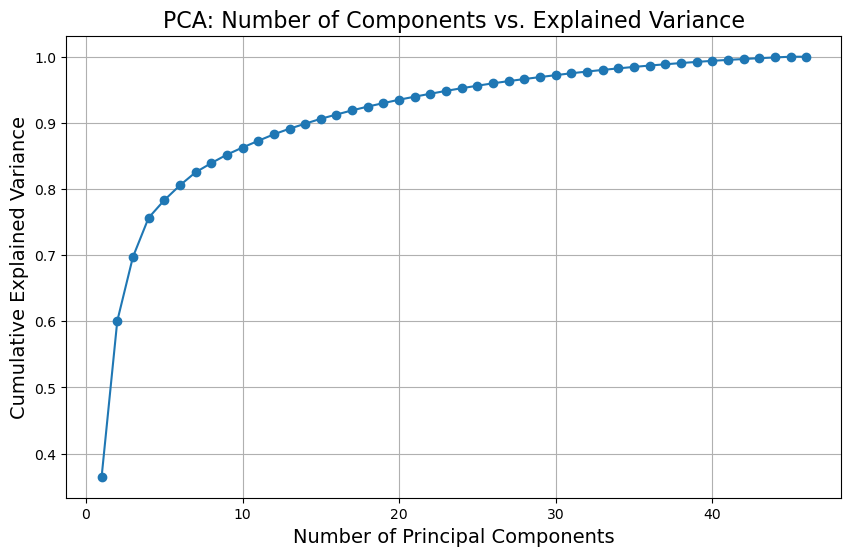

In [20]:
stacked_signatures_np = stacked_signatures.detach().cpu().numpy()
print(f'Stacked signatures in numpy: {stacked_signatures_np.shape}')

scaler = StandardScaler()
signatures_np = scaler.fit_transform(stacked_signatures_np)

# Apply PCA to reduce dimensionality
pca = PCA()
pca.fit(signatures_np)
signatures_pca = pca.transform(signatures_np)
explained_variance = pca.explained_variance_ratio_
cumulative_explained_variance = explained_variance.cumsum()

num_components_95 =  next(i for i, total in enumerate(cumulative_explained_variance) if total > 0.995)+1

print(f"Number of components : {num_components_95}")
reduced_space= signatures_pca[:,:num_components_95]
print(f'PCA Reduced space: {reduced_space.shape}')


# Plot variance explained vs. number of components
plt.figure(figsize=(10, 6))
plt.plot(np.arange(1, len(explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='-')
plt.xlabel("Number of Principal Components", fontsize=14)
plt.ylabel("Cumulative Explained Variance", fontsize=14)
plt.title("PCA: Number of Components vs. Explained Variance", fontsize=16)
plt.grid()
#plt.savefig('nwp_pca.pdf')
plt.show()


In [21]:
components = pca.components_
unique_interaction_terms = set()

for i, component in enumerate(components):
    most_contributing_feature =np.argmax(np.abs(component))  # Get index of the highest absolute value
    win= most_contributing_feature // signatures[0][0].shape[1]
    col_within_window = most_contributing_feature % signatures[0][0].shape[1]

    depth, interaction_term = pathsig.map_column_to_interaction(col_within_window, channels=3332, max_depth=2)
    unique_interaction_terms.add(interaction_term)

    print(f"Principal Component {i+1}: Feature {most_contributing_feature} is the most important Depth {depth}, window {win}, Interaction Term: {interaction_term}")

# Print unique interaction terms
print("\nUnique Interaction Terms:")
for term in unique_interaction_terms:
    print(term)


# Use a set to find unique values
unique_values = set()

# Iterate through the list and add values to the set
for term in unique_interaction_terms:
    unique_values.update(term)

# Convert the set back to a sorted list for better readability
unique_values = sorted(unique_values)

# Print the unique values
print("Unique Values:", unique_values)
print(len(unique_values))

Principal Component 1: Feature 5133 is the most important Depth 1, window 1, Interaction Term: (1800,)
Principal Component 2: Feature 1596 is the most important Depth 1, window 0, Interaction Term: (1596,)
Principal Component 3: Feature 14585 is the most important Depth 1, window 4, Interaction Term: (1253,)
Principal Component 4: Feature 21330 is the most important Depth 1, window 6, Interaction Term: (1332,)
Principal Component 5: Feature 13380 is the most important Depth 1, window 4, Interaction Term: (48,)
Principal Component 6: Feature 15534 is the most important Depth 1, window 4, Interaction Term: (2202,)
Principal Component 7: Feature 15984 is the most important Depth 1, window 4, Interaction Term: (2652,)
Principal Component 8: Feature 13634 is the most important Depth 1, window 4, Interaction Term: (302,)
Principal Component 9: Feature 13987 is the most important Depth 1, window 4, Interaction Term: (655,)
Principal Component 10: Feature 20005 is the most important Depth 1, w

(1, 41.56772232055664, -90.51870727539062)
(2, 41.54956817626953, -90.27157592773438)
(3, 41.91356658935547, -87.95968627929688)
(4, 43.12455749511719, -87.8741455078125)
(5, 43.39535903930664, -87.76104736328125)


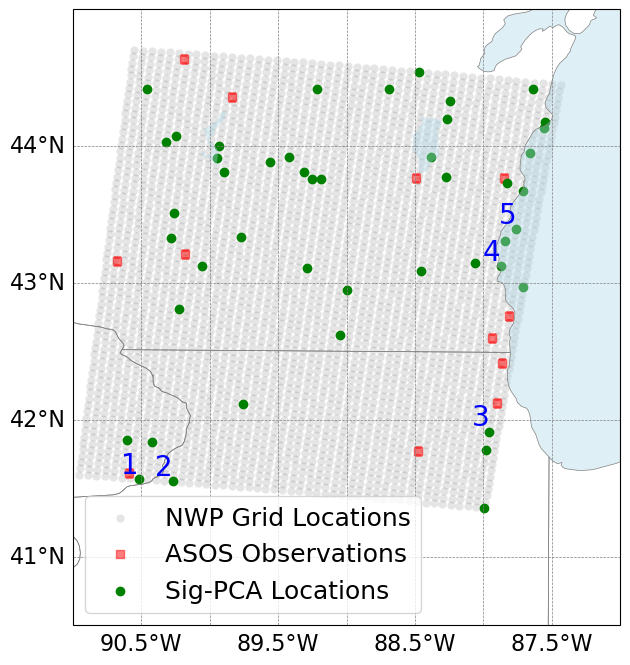

In [26]:
# Create a figure with a map projection
plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.PlateCarree())

# Scatter plot of all locations first (this will appear on top of the map features)
ax.scatter(long_flat, lat_flat, c='black', marker='o', edgecolor='white', alpha=0.1, label='NWP Grid Locations', transform=ccrs.PlateCarree())
ax.scatter(lon_obs, lat_obs, c='red', marker='s', alpha=0.5, label='ASOS Observations', transform=ccrs.PlateCarree())
ax.scatter(long_flat[unique_values], lat_flat[unique_values], c='green', marker='o', label='Sig-PCA Locations', transform=ccrs.PlateCarree())

# Define the specific indices to label
label_indices = {1, 2, 7,18,22}
selected_points = [(lon, lat) for idx, (lon, lat) in enumerate(zip(long_flat[unique_values], lat_flat[unique_values]), start=1) if idx in label_indices]

# Label only the selected locations with consecutive numbers (1, 2, 3, ...)
for new_idx, (lon, lat) in enumerate(selected_points, start=1):
    print((new_idx, lat,lon))
    ax.text(lon, lat, str(new_idx), fontsize=20, ha='right', va='bottom', color='blue', transform=ccrs.PlateCarree())

# Add natural features for context
ax.add_feature(cfeature.LAND, facecolor='white')
ax.add_feature(cfeature.LAKES, facecolor='lightblue', alpha=0.4)  # Lakes with transparency
ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=1, edgecolor='black')
ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5)

# Set the extent of the map (bounding box for the region of interest)
ax.set_extent([-91, -87, 40.5, 45], crs=ccrs.PlateCarree())

# Add a grid for better readability
gridlines = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', linestyle='--')
gridlines.top_labels = False
gridlines.right_labels = False

# Increase axis label font size
gridlines.xlabel_style = {'size': 16}  # X-axis label font size
gridlines.ylabel_style = {'size': 16}  # Y-axis label font size
ax.tick_params(axis='both', which='major', labelsize=16)  # Increase tick label font size

# Add title and legend
plt.legend(loc='lower left', fontsize=18)
#plt.savefig('nwp_contributions.pdf')

# Show the plot
plt.show()


Processing hierarchical dyadic window depth 1 with 1 sub-windows
Sub-window 1 : Start = 0, End = 16
Processing hierarchical dyadic window depth 2 with 2 sub-windows
Sub-window 1 : Start = 0, End = 8
Sub-window 2 : Start = 8, End = 16
Processing hierarchical dyadic window depth 3 with 4 sub-windows
Sub-window 1 : Start = 0, End = 4
Sub-window 2 : Start = 4, End = 8
Sub-window 3 : Start = 8, End = 12
Sub-window 4 : Start = 12, End = 16


Location 11 fluctuations: [2.52852463722229, 2.45876407623291, 2.3412723541259766, 2.806807041168213, 1.724876880645752, 1.5267293453216553, 1.31696617603302]
Location 48 fluctuations: [2.6031622886657715, 2.7974753379821777, 2.6010866165161133, 2.5832223892211914, 1.4229662418365479, 1.6471596956253052, 1.5685651302337646]
Location 1926 fluctuations: [2.6960690021514893, 2.950105667114258, 2.8083224296569824, 3.0225093364715576, 1.3451541662216187, 1.9211254119873047, 1.32991361618042]
Location 2413 fluctuations: [2.7539005279541016, 2.8298721313476562, 2.3728508949279785, 2.921902656555176, 1.2826107740402222, 1.408897042274475, 1.1598033905029297]
Location 655 fluctuations: [2.5503077507019043, 2.5077662467956543, 2.6385467052459717, 2.696671962738037, 1.3195899724960327, 1.6473934650421143, 1.4861626625061035]


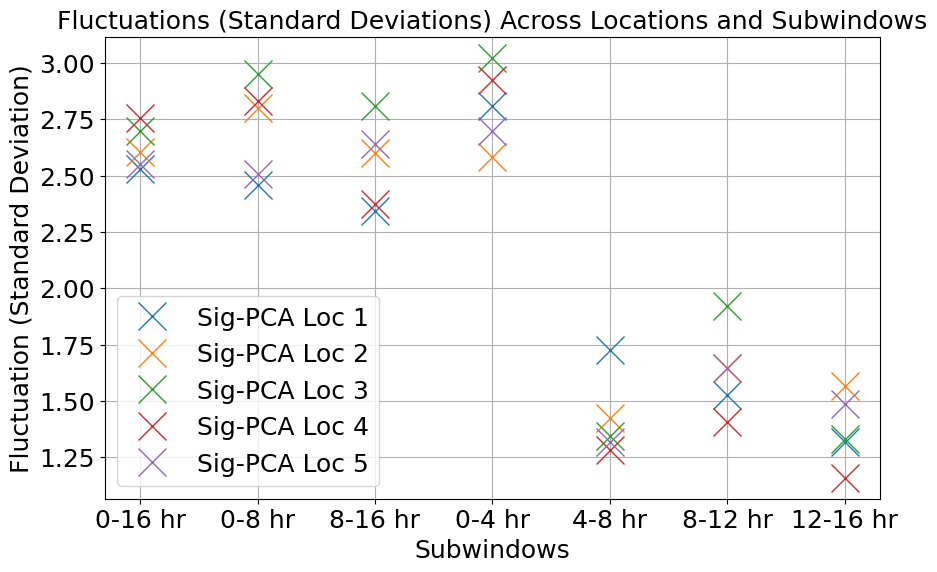

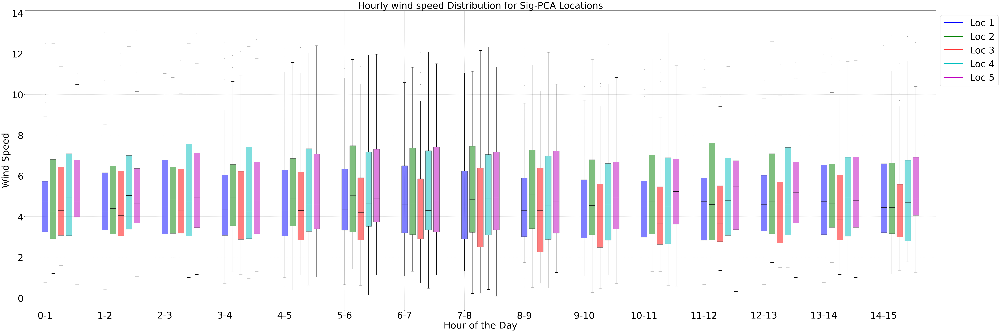

In [28]:
# Initialize an empty list to store the sigpca values
sigpca_values = []

# Loop over each index in label_indices
for i in label_indices:
    # Compute or access the sigpca value for the current index
    sigpca = unique_values[i]  # Assuming unique_values[i] is the value you want
    sigpca_values.append(sigpca)


# Calculate the number of rows and columns for the subplots
depth = 3
num_depths = len(windows[0:depth])  # Number of depth levels
max_sub_windows = max(len(window_list) for window_list in windows[0:depth])  # Maximum number of sub-windows at any depth

# Create a figure with appropriate size
fig, axes = plt.subplots(num_depths, max_sub_windows, figsize=(100, 80), squeeze=False)

# Initialize subplot counter
sub_window_counter = 0

# Store labels for a shared legend
labels = [f'Sig-PCA Loc {i +1}' for i in range(len(label_indices))]  # Assuming at most 10 signature columns
#labels = [f'Sig-PCA Loc {i +1}' for i in range(len(unique_values))]  # Assuming at most 10 signature columns

# Initialize an empty dictionary to store the fluctuations for each location
fluctuations = {}

# Loop over each depth and its sub-windows
for depth_idx, window_list in enumerate(windows[0:depth]):
    print(f"Processing hierarchical dyadic window depth {depth_idx + 1} with {len(window_list)} sub-windows")
    
    for sub_window_idx, pair in enumerate(window_list):
        # Extract the start and end indices of the current sub-window
        start_idx, end_idx = pair.start, pair.end
        print(f"Sub-window {sub_window_idx + 1} : Start = {start_idx}, End = {end_idx}")

        # Extract the corresponding signature for the current window and sub-window (assuming signature is a PyTorch tensor)
        signature = signatures[depth_idx][sub_window_idx]

        # Calculate fluctuations for each location (standard deviation of signature terms)
        for i in sigpca_values:  # Ensure we don't exceed the number of columns in signature
            loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
            if i not in fluctuations:
                fluctuations[i] = []
            fluctuations[i].append(loc_fluctuation)

        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
        #     if i not in fluctuations:
        #         fluctuations[i] = []
        #     fluctuations[i].append(loc_fluctuation)


        # Plot the first 100 terms of the signature for this sub-window
        ax = axes[depth_idx, sub_window_idx]  # Get the corresponding subplot
        for i in sigpca_values: 
            # Convert x-axis indices to time in hours, then to days
            num_rows=signature.shape[0]
            x_hours = np.arange(num_rows) * 15  # Each row represents 15 hours
            x_days = x_hours / 24  # Convert hours to days
            
            
            ax.plot(x_days, signature[:, i].numpy())  # Plotting against days
            
            


            #ax.plot(signature[:, i].numpy())  # Convert to NumPy for plotting
        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     ax.plot(signature[:, i].numpy())  # Convert to NumPy for plotting

    
        # Set title and labels with increased font sizes
        ax.set_xticks(np.arange(0, np.max(x_days) + 1, 5))  # Set major ticks at every 1 day
        ax.set_title(f'Sub-window {sub_window_idx + 1}\nHourly Steps {start_idx}-{end_idx}', fontsize=100)
        ax.set_xlabel('Days', fontsize=100)
        ax.set_ylabel('Signature Value', fontsize=100)

        # Increase tick label font size
        ax.tick_params(axis='both', which='major', labelsize=100)

# Remove empty subplots if there are any
for depth_idx in range(num_depths):
    for sub_window_idx in range(len(windows[depth_idx]), max_sub_windows):
        fig.delaxes(axes[depth_idx, sub_window_idx])

# Add a shared legend for the figure with increased font size
fig.legend(labels, loc='center right', fontsize=100, title="Signature Terms", title_fontsize=100, bbox_to_anchor=(0.9, 0.5))

# Adjust layout to avoid overlapping subplots
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space on the right for the legend

#plt.savefig('nwp_signatures_hierarchical.pdf')
plt.show()

# Print the fluctuations for each location
for loc, fluct in fluctuations.items():
    print(f"Location {loc} fluctuations: {fluct}")

# Define the subwindow labels
subwindow_labels = ['0-16 hr', '0-8 hr', '8-16 hr', '0-4 hr', '4-8 hr', '8-12 hr', '12-16 hr']

# Create the plot
plt.figure(figsize=(10, 6))

# Loop through each location's fluctuations and plot
for i, (loc, fluct) in enumerate(fluctuations.items(), start=1):
    plt.plot(range(1, 8), fluct,marker='x',markersize=20, linestyle='', label=f'Sig-PCA Loc {i}')

# Customize the plot
plt.title("Fluctuations (Standard Deviations) Across Locations and Subwindows", fontsize=18)
plt.xlabel("Subwindows", fontsize=18)
plt.ylabel("Fluctuation (Standard Deviation)", fontsize=18)
plt.xticks(range(1, 8), subwindow_labels, fontsize=18)
plt.yticks(fontsize=18)
plt.legend(loc="lower left", fontsize=18)
plt.grid(True)
plt.savefig('nwpfluctuations.pdf')
plt.show()

# Define hourly time steps (x-axis)
hourly_steps = np.arange(0, 15)  # 15 hourly bins from 0 to 16

# Convert tensor to NumPy for easy handling
data_np = nwp_tensor.numpy()  # Shape: (46, 15, 3332)

# Define distinct colors for each location
colors = ['b', 'g', 'r', 'c', 'm']  # Blue, Green, Red, Cyan, Magenta

# Create a single figure for all box plots
plt.figure(figsize=(60, 20))  # Increase width to fit all box plots comfortably

# Loop through each location and add its box plot
for i, loc in enumerate(sigpca_values):
    if i >= data_np.shape[0]:  # Ensure location index is within bounds
        continue
    
    # Extract wind speed data for the location across all hours
    wind_speeds = data_np[:, :, loc].T  # Shape: (15, 3332) -> hourly wind speed distributions
    
    # Create a box plot for this location with unique color
    # The positions are directly hourly_steps, with slight offset for each location
    plt.boxplot(wind_speeds.T, positions=(hourly_steps*1.5) + (i * 0.2), widths=0.15, patch_artist=True, 
                boxprops=dict(facecolor=colors[i], alpha=0.5), 
                medianprops=dict(color="black"), flierprops=dict(marker='o', markersize=2, alpha=0.5))

# Customize the plot
plt.title("Hourly wind speed Distribution for Sig-PCA Locations", fontsize=40)
plt.xlabel("Hour of the Day", fontsize=40)
plt.ylabel("Wind Speed", fontsize=40)
plt.xticks(hourly_steps*1.5, labels=[f"{h}-{h+1}" for h in hourly_steps], fontsize=40)
plt.yticks(fontsize=40)  # Increase y-axis tick font size
plt.grid(True, linestyle="--", alpha=0.5)

# Manually create legend entries using Line2D to ensure correct color mapping
legend_handles = [Line2D([0], [0], color=color, lw=4) for color in colors]

# Add legend mapping colors to locations and place it outside the plot
# Use labels '1', '2', '3', etc., instead of location numbers
plt.legend(legend_handles, [f"Loc {i+1}" for i in range(len(sigpca_values))], loc="upper left", fontsize=40, bbox_to_anchor=(1, 1), ncol=1)

# Adjust layout and ensure everything fits without overlap
plt.tight_layout()

# Show the plot
#plt.savefig('nwp_boxplot.pdf')
plt.show()


# Neural network training: 4% dataset sigpca+DK as I/P to output NWP

In [31]:
lon_sigpca_1=long_flat[unique_values]
lat_sigpca_1=lat_flat[unique_values]


# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")


Test input shape nwp grid: torch.Size([153272, 1873])
Test output shape nwp grid: torch.Size([153272, 15])


In [32]:
# Training--# Define sample sizes
percent = 4
total_size = 3332
sample_size = round((percent / 100) * total_size)

mse_results = []
length=46
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

# Randomly select a subset of lat/lon points
np.random.seed(4)
indices = np.random.choice(len(lat_flat), sample_size, replace=False)
lat_subset = lat_flat[indices]
long_subset = long_flat[indices]

llong=np.array(long_subset)
llat= np.array(lat_subset)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_subset), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)

# Prepare input data
augmented_cols = []
for i in range(sample_size):
    lat_lon_column = np.column_stack((np.full(length, lat_subset[i]), np.full(length, long_subset[i])))
    basis_column = np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((reduced_space, lat_lon_column, basis_column))
    augmented_cols.append(augmented_chunk)

input_subset = np.vstack(augmented_cols)
target_subset = np.vstack([nwp_tensor[:, :, i] for i in indices])

# Convert to PyTorch tensors
inputs_tensor = torch.tensor(input_subset, dtype=torch.float32)
targets_tensor = torch.tensor(target_subset, dtype=torch.float32)
print(f'Input shape: {inputs_tensor.shape}')
print(f'Output NWP at fixed grid shape: {targets_tensor.shape}')

# Train the neural network
model = nnmodule.SimpleNNpos(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
criterion = nn.MSELoss()

num_epochs = 5000  # Reduce training iterations for efficiency
for epoch in range(num_epochs):
    optimizer.zero_grad()
    outputs = model(inputs_tensor)
    loss = criterion(outputs, targets_tensor)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

# Evaluate model
with torch.no_grad():
    predictions_val = model(testinput_tensor)



Input shape: torch.Size([6118, 1873])
Output NWP at fixed grid shape: torch.Size([6118, 15])
Epoch [100/5000], Loss: 0.5630
Epoch [200/5000], Loss: 0.3126
Epoch [300/5000], Loss: 0.2318
Epoch [400/5000], Loss: 0.2690
Epoch [500/5000], Loss: 0.1565
Epoch [600/5000], Loss: 0.1549
Epoch [700/5000], Loss: 0.1256
Epoch [800/5000], Loss: 0.1146
Epoch [900/5000], Loss: 0.1056
Epoch [1000/5000], Loss: 0.0992
Epoch [1100/5000], Loss: 0.0971
Epoch [1200/5000], Loss: 0.0976
Epoch [1300/5000], Loss: 0.0909
Epoch [1400/5000], Loss: 0.0900
Epoch [1500/5000], Loss: 0.0800
Epoch [1600/5000], Loss: 0.0890
Epoch [1700/5000], Loss: 0.0832
Epoch [1800/5000], Loss: 0.0901
Epoch [1900/5000], Loss: 0.0716
Epoch [2000/5000], Loss: 0.0866
Epoch [2100/5000], Loss: 0.0682
Epoch [2200/5000], Loss: 0.0666
Epoch [2300/5000], Loss: 0.0659
Epoch [2400/5000], Loss: 0.0646
Epoch [2500/5000], Loss: 0.0646
Epoch [2600/5000], Loss: 0.0635
Epoch [2700/5000], Loss: 0.0644
Epoch [2800/5000], Loss: 0.0658
Epoch [2900/5000], L

In [38]:
mse = F.mse_loss(predictions_val, testtarget_tensor).item()
print(f"Sample size: {sample_size},  MSE between reconstructed NWP and true NWP entire grid: {mse:.4f}")

nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])

obstestgrid = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))
for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = flattened_trimmed_nwp[i, :]
    flattened_series_nwp = blocknwp.flatten()

    blockpredsgrid = predictions_val[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()
    obstestgrid[i, :] = flattened_series_predsgrid
print(obstestgrid.shape)

sigpca_dk_nwp_4percent=obstestgrid

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid, axis=1)
variance_values_obs = np.std(obstestgrid, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# # Plot the mean heatmap using scatter
# plt.figure(figsize=(12, 6))  
# plt.subplot(1, 2, 1)
# sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Mean NWP')

# plt.subplot(1, 2, 2)
# sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc2,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Mean Recon NWP')

# plt.tight_layout()
# plt.show()


# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc3,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Standard deviation NWP')

# plt.subplot(1, 2, 2)
# sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc4,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Standard deviation Recon NWP')
# plt.tight_layout()
# plt.show()


Sample size: 133,  MSE between reconstructed NWP and true NWP entire grid: 0.7264
(3332, 690)


# Train only on 4% of NWP GRID and output ASOS Grid with Sig-PCA+DK and NWP Correction

In [42]:
closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(len(closest_indices))

12


In [44]:
# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")


Test input shape nwp grid: torch.Size([153272, 1873])
Test output shape nwp grid: torch.Size([153272, 15])


In [45]:
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

llong=np.array(lon_obs)
llat= np.array(lat_obs)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_obs), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)


num_basis = [10**2,19**2,37**2]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

length=nwp_tensor.shape[0]
augmented_cols = []
for i in range(len(lat_obs)):
    chunk = reduced_space
    lat_lon_column = np.column_stack((np.full(length, lat_obs[i]), np.full(length, lon_obs[i])))
    basiscolumn= np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

input = np.vstack(augmented_cols)
print(f'Training on OBS lat long and sig PCA: {input.shape}')

recon_nwp_3332=np.zeros(nwp_tensor.shape)
for i in range(nwp_tensor.shape[2]):
    recon_nwp_3332[:, :, i] = torch.from_numpy(sigpca_dk_nwp_4percent[i, :].reshape(nwp_tensor.shape[0],nwp_tensor.shape[1])).float()
print(f'Shape of reconstructed NWP : {recon_nwp_3332.shape}')

recon_nwp_3332_closestin=np.vstack([recon_nwp_3332[:, :, i] for i in closest_indices])
print(f'Shape of reconstructed NWP at obs locations: {recon_nwp_3332_closestin.shape}')

# output is OBS-reconstructed NWP[ closest indices]
output= obsstack-recon_nwp_3332_closestin
print(f'Correction output: {output.shape}')

input_size = input.shape[1]
output_size = output.shape[1]


nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 


model = nnmodule.SimpleNN(input_size,output_size)

optimizer = optim.Adam(model.parameters(), lr=0.01) #0.01 is good

inputs_tensor=torch.tensor(input, dtype=torch.float32)
print(f"Input shape: {inputs_tensor.shape}")
targets_tensor=torch.tensor(output, dtype=torch.float32)
print(f"Output shape : {targets_tensor.shape}")

num_epochs = 5000

for epoch in range(num_epochs):
    optimizer.zero_grad()  
    outputs = model(inputs_tensor) 
    loss = nnmodule.custom_loss(outputs, targets_tensor,nwpstacktensor)
    loss.backward()  
    optimizer.step()  
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

with torch.no_grad(): 
    predictions = model(testinput_tensor) 

targets_np = targets_tensor.cpu().numpy() 
predictions_np = predictions.cpu().numpy() 


obstestgrid_recon = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))

for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = sigpca_dk_nwp_4percent[i, :]
    flattened_series_nwp_recon = blocknwp.flatten()

    blockpredsgrid = predictions_np[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()

    obstestgrid_recon[i, :] = flattened_series_nwp_recon + flattened_series_predsgrid

print(obstestgrid_recon.shape)

sigpca_dk_grid_corr_4percent=obstestgrid_recon


Training on OBS lat long and sig PCA: (552, 1873)
Shape of reconstructed NWP : (46, 15, 3332)
Shape of reconstructed NWP at obs locations: (552, 15)
Correction output: (552, 15)
nwpobsgrid shape: torch.Size([46, 15, 12])
NWP stacked shape: (552, 15)
NWP stacked tensor shape: torch.Size([552, 15])
Input shape: torch.Size([552, 1873])
Output shape : torch.Size([552, 15])
Epoch [100/5000], Loss: 2.2421
Epoch [200/5000], Loss: 2.1364
Epoch [300/5000], Loss: 1.5650
Epoch [400/5000], Loss: 1.3249
Epoch [500/5000], Loss: 1.6098
Epoch [600/5000], Loss: 1.1664
Epoch [700/5000], Loss: 1.2867
Epoch [800/5000], Loss: 1.4247
Epoch [900/5000], Loss: 0.7233
Epoch [1000/5000], Loss: 0.5612
Epoch [1100/5000], Loss: 3.9433
Epoch [1200/5000], Loss: 1.5144
Epoch [1300/5000], Loss: 1.0476
Epoch [1400/5000], Loss: 0.8697
Epoch [1500/5000], Loss: 2.3131
Epoch [1600/5000], Loss: 0.9748
Epoch [1700/5000], Loss: 0.7793
Epoch [1800/5000], Loss: 0.6716
Epoch [1900/5000], Loss: 1.8160
Epoch [2000/5000], Loss: 0.88

In [40]:
mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid_recon, axis=1)
variance_values_obs = np.std(obstestgrid_recon, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# # Plot the mean heatmap using scatter
# plt.figure(figsize=(12, 6))  
# plt.subplot(1, 2, 1)
# sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Mean NWP')

# plt.subplot(1, 2, 2)
# sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc2,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Mean ASOS corrected Recon NWP')

# plt.tight_layout()
# plt.show()


# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc3,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Standard deviation NWP')

# plt.subplot(1, 2, 2)
# sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc4,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Standard deviation ASOS corrected Recon NWP')
# plt.tight_layout()
# plt.show()


NameError: name 'obstestgrid_recon' is not defined

# save and load outputs

In [35]:
# np.save("sigpca_dk_nwp_4percent.npy", sigpca_dk_nwp_4percent)
# np.save("sigpca_dk_grid_corr_4percent.npy", sigpca_dk_grid_corr_4percent)

sigpca_dk_nwp_4percent= np.load("sigpca_dk_nwp_4percent.npy")
sigpca_dk_grid_corr_4percent = np.load("sigpca_dk_grid_corr_4percent.npy")

# Require/Train only on 4% of NWP GRID and output whole NWP Grid with EOF+DK

torch.Size([46, 49980])


/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_54673/348690892.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  nwpsvdtensor= torch.tensor(reshaped_data, dtype=torch.float32)


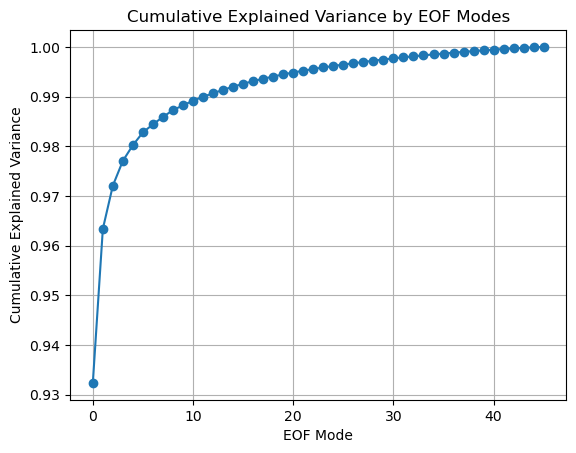

Number of components explaining 99% variance: 22


In [54]:
data = nwp_tensor 
# Reshape to (timesteps, features*locations)
num_timesteps, num_features, num_locs = data.shape
reshaped_data = data.reshape(num_timesteps, num_features * num_locs)  # Shape: (320, 24*5120)

nwpsvdtensor= torch.tensor(reshaped_data, dtype=torch.float32)

print(nwpsvdtensor.shape)
U, S, V = torch.svd(nwpsvdtensor)

#Calculate explained variance
# Square the singular values to get the variance explained by each mode
singular_values_squared = S**2

# Calculate total variance
total_variance = torch.sum(singular_values_squared)

# Calculate explained variance for each mode
explained_variance = singular_values_squared / total_variance
# Calculate cumulative variance explained by the first k modes
cumulative_variance = torch.cumsum(explained_variance,dim=0)

# Step 5: Plot the cumulative explained variance
plt.figure()
plt.plot(cumulative_variance.numpy(), marker='o')
plt.title('Cumulative Explained Variance by EOF Modes')
plt.xlabel('EOF Mode')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
#plt.savefig('nwp_eofmodes.pdf')
plt.show()

num_components_95 = next(i for i, total in enumerate(cumulative_variance) if total > 0.995)+1

print(f"Number of components explaining 99% variance: {num_components_95}")


# Select the number of EOF modes (latent space size)
#  keep the first k EOF modes
k = num_components_95
V_k = V[:k, :]  # Use the first k columns of V (right singular vectors)
U_reduced = U[:, :k]  
S_reduced = S[:k]     
V_reduced = V[:, :k]   



In [56]:
reduced_data = U_reduced #@ torch.diag(S_reduced) @ V_reduced.T
print(f"EOF  space dimension {reduced_data.shape}")

EOF  space dimension torch.Size([46, 22])


Test input nwp grid: torch.Size([153272, 1854])
Test output shape nwp grid: torch.Size([153272, 15])
Input shape: torch.Size([6118, 1854])
Output shape: torch.Size([6118, 15])
nwpobsgrid shape: torch.Size([46, 15, 12])
NWP stacked shape: (552, 15)
NWP stacked tensor shape: torch.Size([552, 15])
Epoch [100/5000], Loss: 0.5565
Epoch [200/5000], Loss: 0.3397
Epoch [300/5000], Loss: 0.3214
Epoch [400/5000], Loss: 0.2313
Epoch [500/5000], Loss: 0.2243
Epoch [600/5000], Loss: 0.1870
Epoch [700/5000], Loss: 0.1777
Epoch [800/5000], Loss: 0.1617
Epoch [900/5000], Loss: 0.1548
Epoch [1000/5000], Loss: 0.1433
Epoch [1100/5000], Loss: 0.2004
Epoch [1200/5000], Loss: 0.1604
Epoch [1300/5000], Loss: 0.1285
Epoch [1400/5000], Loss: 0.1236
Epoch [1500/5000], Loss: 0.1205
Epoch [1600/5000], Loss: 0.1319
Epoch [1700/5000], Loss: 0.1220
Epoch [1800/5000], Loss: 0.1437
Epoch [1900/5000], Loss: 0.1146
Epoch [2000/5000], Loss: 0.1101
Epoch [2100/5000], Loss: 0.1634
Epoch [2200/5000], Loss: 0.1056
Epoch [23

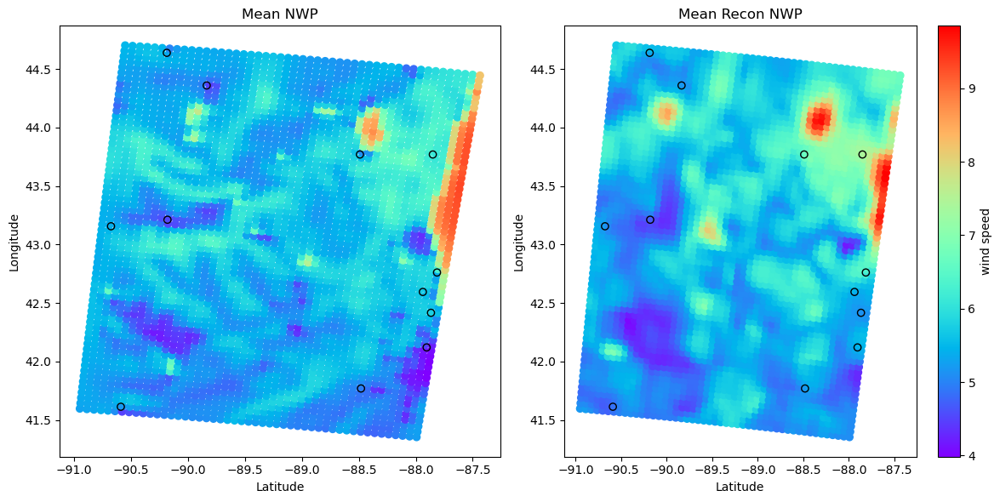

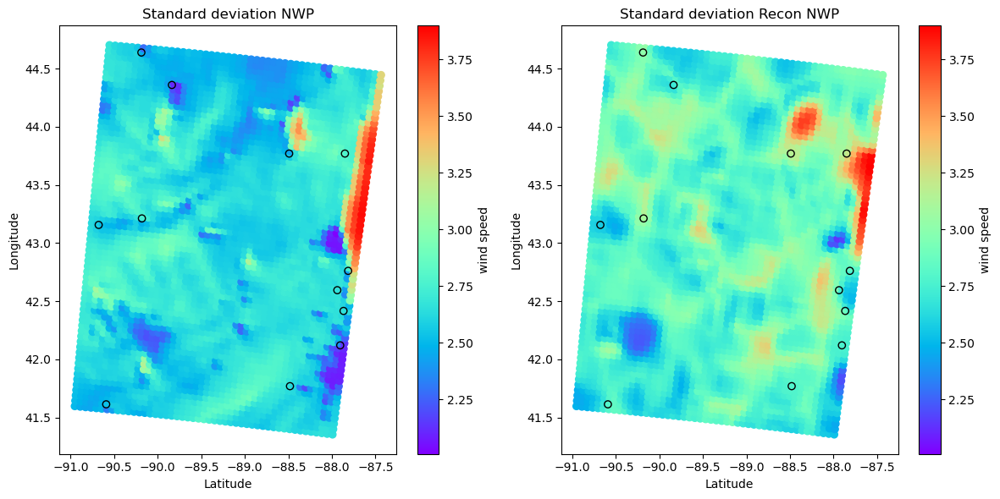

In [60]:
# TESTING INPUT
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

length= reduced_data.shape[0]
phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Remove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_data
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input nwp grid: {testinput_tensor.shape}")

#
testtarget = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")
percent = 4
total_size = 3332
sample_size = round((percent / 100) * total_size)

length= nwp_tensor.shape[0]
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

np.random.seed(42)
indices = np.random.choice(len(lat_flat), sample_size, replace=False)
lat_subset = lat_flat[indices]
long_subset = long_flat[indices]


llong=np.array(long_subset)
llat= np.array(lat_subset)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_subset), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)

# Prepare input data
augmented_cols = []
for i in range(sample_size):
    lat_lon_column = np.column_stack((np.full(length, lat_subset[i]), np.full(length, long_subset[i])))
    basis_column = np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((reduced_data, lat_lon_column, basis_column))
    augmented_cols.append(augmented_chunk)

input_subset = np.vstack(augmented_cols)
target_subset = np.vstack([nwp_tensor[:, :, i] for i in indices])

# Convert to PyTorch tensors
inputs_tensor = torch.tensor(input_subset, dtype=torch.float32)
targets_tensor = torch.tensor(target_subset, dtype=torch.float32)
print(f'Input shape: {inputs_tensor.shape}')
print(f'Output shape: {targets_tensor.shape}')

nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 

model = nnmodule.SimpleNNpos(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
criterion = nn.MSELoss()


# Train the neural network
model = nnmodule.SimpleNN(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
num_epochs = 5000  # Reduce training iterations for efficiency
for epoch in range(num_epochs):
    optimizer.zero_grad()
    outputs = model(inputs_tensor)
    loss = criterion(outputs, targets_tensor)
    loss.backward()
    optimizer.step()
    # Print loss every 10 epochs
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

# Evaluate model
with torch.no_grad():
    predictions = model(testinput_tensor)

mse = F.mse_loss(predictions, testtarget_tensor).item()
print(f"Sample size: {sample_size},  MSE between reconstructed NWP and true NWP entire grid: {mse:.4f}")

nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])

obstestgrid = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))
for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = flattened_trimmed_nwp[i, :]
    flattened_series_nwp = blocknwp.flatten()

    blockpredsgrid = predictions[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()
    obstestgrid[i, :] = flattened_series_predsgrid
print(obstestgrid.shape)

eof_dk_nwp_4percent=obstestgrid

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid, axis=1)
variance_values_obs = np.std(obstestgrid, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# Plot the mean heatmap using scatter
plt.figure(figsize=(12, 6))  
plt.subplot(1, 2, 1)
sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean NWP')

plt.subplot(1, 2, 2)
sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc2,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean Recon NWP')

plt.tight_layout()
plt.show()


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc3,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation NWP')

plt.subplot(1, 2, 2)
sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc4,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation Recon NWP')
plt.tight_layout()
plt.show()


# Require/Train only on 4% of NWP GRID and output ASOS Grid with EOF+DK and NWP Correction

In [63]:
closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(len(closest_indices))

12


In [67]:
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

llong=np.array(lon_obs)
llat= np.array(lat_obs)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_obs), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)


num_basis = [10**2,19**2,37**2]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

length=nwp_tensor.shape[0]
augmented_cols = []
for i in range(len(lat_obs)):
    chunk = reduced_data
    lat_lon_column = np.column_stack((np.full(length, lat_obs[i]), np.full(length, lon_obs[i])))
    basiscolumn= np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

input = np.vstack(augmented_cols)
print(f'Training on OBS lat long and sig PCA: {input.shape}')

recon_nwp_3332=np.zeros(nwp_tensor.shape)
for i in range(nwp_tensor.shape[2]):
    recon_nwp_3332[:, :, i] = torch.from_numpy(eof_dk_nwp_4percent[i, :].reshape(nwp_tensor.shape[0],nwp_tensor.shape[1])).float()
print(f'Shape of reconstructed NWP : {recon_nwp_3332.shape}')

recon_nwp_3332_closestin=np.vstack([recon_nwp_3332[:, :, i] for i in closest_indices])
print(f'Shape of reconstructed NWP at obs locations : {recon_nwp_3332_closestin.shape}')

# output is OBS-reconstructed NLDAS[ closest indices]
output= obsstack-recon_nwp_3332_closestin
print(f'Correction output: {output.shape}')

nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 


input_size = input.shape[1]
output_size = output.shape[1]

model = nnmodule.SimpleNN(input_size,output_size)
optimizer = optim.Adam(model.parameters(), lr=0.01) #0.01 is good

inputs_tensor=torch.tensor(input, dtype=torch.float32)
print(f"Input shape: {inputs_tensor.shape}")
targets_tensor=torch.tensor(output, dtype=torch.float32)
print(f"Output shape : {targets_tensor.shape}")

num_epochs = 5000

for epoch in range(num_epochs):
    optimizer.zero_grad()  
    outputs = model(inputs_tensor) 
    loss = nnmodule.custom_loss(outputs, targets_tensor,nwpstacktensor)
    loss.backward()  
    optimizer.step()  
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

with torch.no_grad(): 
    predictions = model(testinput_tensor) 

targets_np = targets_tensor.cpu().numpy() 
predictions_np = predictions.cpu().numpy() 


obstestgrid_recon = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))

for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = eof_dk_nwp_4percent[i, :]
    flattened_series_nwp_recon = blocknwp.flatten()

    blockpredsgrid = predictions_np[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()

    obstestgrid_recon[i, :] = flattened_series_nwp_recon + flattened_series_predsgrid

print(obstestgrid_recon.shape)

eof_dk_grid_corr_4percent=obstestgrid_recon


Training on OBS lat long and sig PCA: (552, 1854)
Shape of reconstructed NWP : (46, 15, 3332)
Shape of reconstructed NWP at obs locations : (552, 15)
Correction output: (552, 15)
nwpobsgrid shape: torch.Size([46, 15, 12])
NWP stacked shape: (552, 15)
NWP stacked tensor shape: torch.Size([552, 15])
Input shape: torch.Size([552, 1854])
Output shape : torch.Size([552, 15])
Epoch [100/5000], Loss: 2.5003
Epoch [200/5000], Loss: 2.0914
Epoch [300/5000], Loss: 2.0551
Epoch [400/5000], Loss: 1.3734
Epoch [500/5000], Loss: 1.2850
Epoch [600/5000], Loss: 1.0687
Epoch [700/5000], Loss: 1.4650
Epoch [800/5000], Loss: 1.0646
Epoch [900/5000], Loss: 1.0120
Epoch [1000/5000], Loss: 1.3261
Epoch [1100/5000], Loss: 0.9035
Epoch [1200/5000], Loss: 0.8803
Epoch [1300/5000], Loss: 0.7667
Epoch [1400/5000], Loss: 0.9031
Epoch [1500/5000], Loss: 1.1433
Epoch [1600/5000], Loss: 0.8237
Epoch [1700/5000], Loss: 0.7015
Epoch [1800/5000], Loss: 0.9201
Epoch [1900/5000], Loss: 0.6604
Epoch [2000/5000], Loss: 0.5

In [37]:
# np.save("eof_dk_nwp_4percent.npy", eof_dk_nwp_4percent)
# np.save("eof_dk_grid_corr_4percent.npy", eof_dk_grid_corr_4percent)

eof_dk_nwp_4percent= np.load("eof_dk_nwp_4percent.npy")
eof_dk_grid_corr_4percent = np.load("eof_dk_grid_corr_4percent.npy")

# Depth 2 on selected locations

In [74]:
# Create an instance of the AddTime transformer
print(f"Original data shape of selected locations: {nwp_tensor[:,:, unique_values].shape}")
add_time = pathsig.AddTime()
append_zero=pathsig.AppendZero()
transformed_ts = add_time.fit_transform(nwp_tensor[:,:, unique_values])
print(f"After adding time as another channel: {transformed_ts.shape}")
final_transformed_ts= append_zero.transform(transformed_ts)
print(f"Augmenting with 0 in time: {final_transformed_ts.shape}")



Original data shape of selected locations: torch.Size([46, 15, 46])
After adding time as another channel: torch.Size([46, 15, 47])
Augmenting with 0 in time: torch.Size([46, 16, 47])


[[Pair(start=0, end=16)], [Pair(start=0, end=8), Pair(start=8, end=16)], [Pair(start=0, end=4), Pair(start=4, end=8), Pair(start=8, end=12), Pair(start=12, end=16)]]
Total windows : 7
Total signatures: len(signatures) 
7
torch.Size([46, 15792])
columnwise signatures: (46, 15792)
Stacked signatures in numpy: (46, 15792)
Number of components : 43
PCA Reduced space: (46, 43)


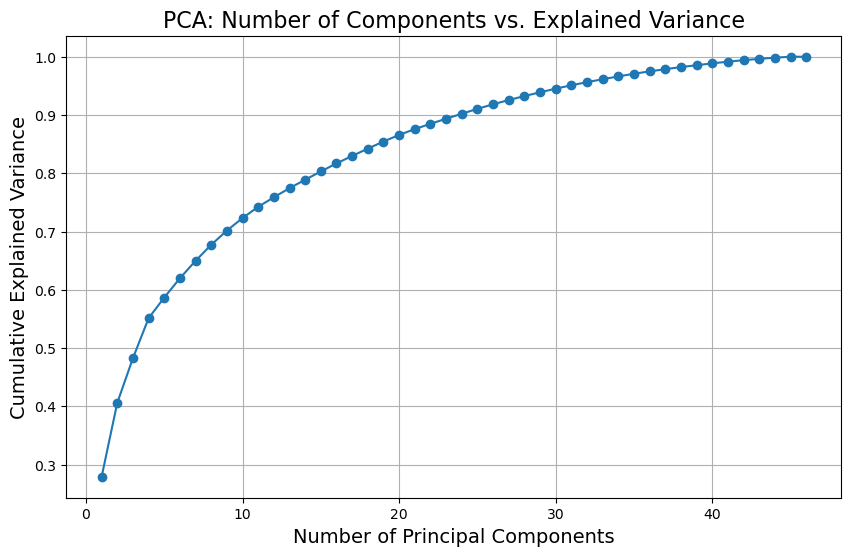

Principal Component 1: Feature 470 is the most important Depth 1, window 0, Interaction Term: (470,)
Principal Component 2: Feature 4974 is the most important Depth 1, window 2, Interaction Term: (462,)
Principal Component 3: Feature 1089 is the most important Depth 1, window 0, Interaction Term: (1089,)
Principal Component 4: Feature 12181 is the most important Depth 1, window 5, Interaction Term: (901,)
Principal Component 5: Feature 10071 is the most important Depth 1, window 4, Interaction Term: (1047,)
Principal Component 6: Feature 5248 is the most important Depth 1, window 2, Interaction Term: (736,)
Principal Component 7: Feature 10889 is the most important Depth 1, window 4, Interaction Term: (1865,)
Principal Component 8: Feature 5566 is the most important Depth 1, window 2, Interaction Term: (1054,)
Principal Component 9: Feature 13299 is the most important Depth 1, window 5, Interaction Term: (2019,)
Principal Component 10: Feature 11585 is the most important Depth 1, windo

Location 50 fluctuations: [1.915860891342163, 0.5039509534835815, 0.7189789414405823, 0.08850648999214172, 0.15139861404895782, 0.17084869742393494, 0.21196073293685913]
Location 54 fluctuations: [1.350074052810669, 0.4368177056312561, 0.5054836273193359, 0.061536580324172974, 0.1529538333415985, 0.09855462610721588, 0.12873952090740204]
Location 736 fluctuations: [27.263126373291016, 26.208703994750977, 6.344406604766846, 29.511837005615234, 2.0437381267547607, 2.377152919769287, 2.165560245513916]
Location 884 fluctuations: [15.199990272521973, 16.554262161254883, 3.7127866744995117, 18.481096267700195, 1.4489794969558716, 1.3737170696258545, 1.592185616493225]
Location 299 fluctuations: [20.00710678100586, 17.249521255493164, 3.7663936614990234, 17.287553787231445, 1.2569204568862915, 1.4445173740386963, 1.5189456939697266]


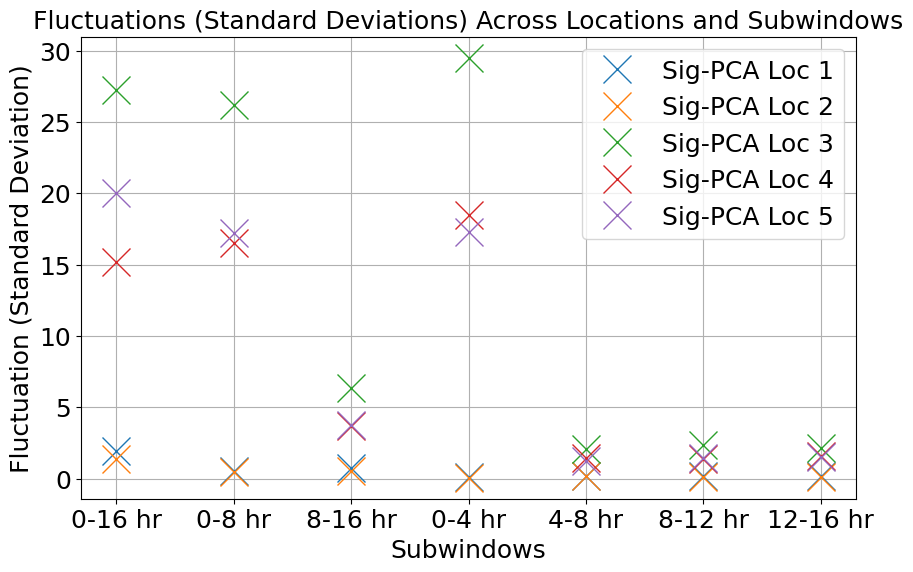

Test input shape nwp grid: torch.Size([153272, 1875])
Test output shape nwp grid: torch.Size([153272, 15])
Input shape: torch.Size([6118, 1875])
Output NWP at fixed grid shape: torch.Size([6118, 15])
Epoch [100/5000], Loss: 0.5312
Epoch [200/5000], Loss: 0.2966
Epoch [300/5000], Loss: 0.2073
Epoch [400/5000], Loss: 0.1692
Epoch [500/5000], Loss: 0.1424
Epoch [600/5000], Loss: 0.1305
Epoch [700/5000], Loss: 0.1171
Epoch [800/5000], Loss: 0.1042
Epoch [900/5000], Loss: 0.0989
Epoch [1000/5000], Loss: 0.0954
Epoch [1100/5000], Loss: 0.0874
Epoch [1200/5000], Loss: 0.0841
Epoch [1300/5000], Loss: 0.0807
Epoch [1400/5000], Loss: 0.0794
Epoch [1500/5000], Loss: 0.0766
Epoch [1600/5000], Loss: 0.0768
Epoch [1700/5000], Loss: 0.0733
Epoch [1800/5000], Loss: 0.0705
Epoch [1900/5000], Loss: 0.0683
Epoch [2000/5000], Loss: 0.0685
Epoch [2100/5000], Loss: 0.0881
Epoch [2200/5000], Loss: 0.0677
Epoch [2300/5000], Loss: 0.0662
Epoch [2400/5000], Loss: 0.0759
Epoch [2500/5000], Loss: 0.0664
Epoch [26

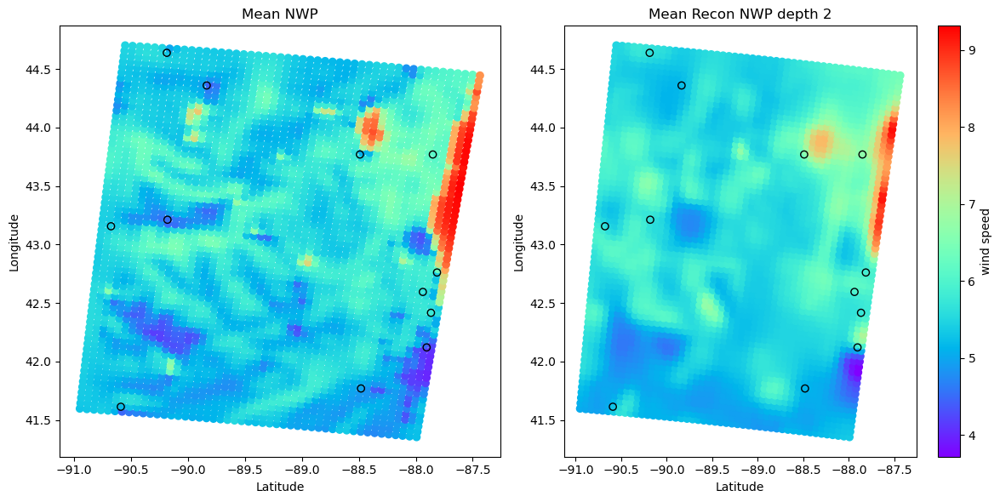

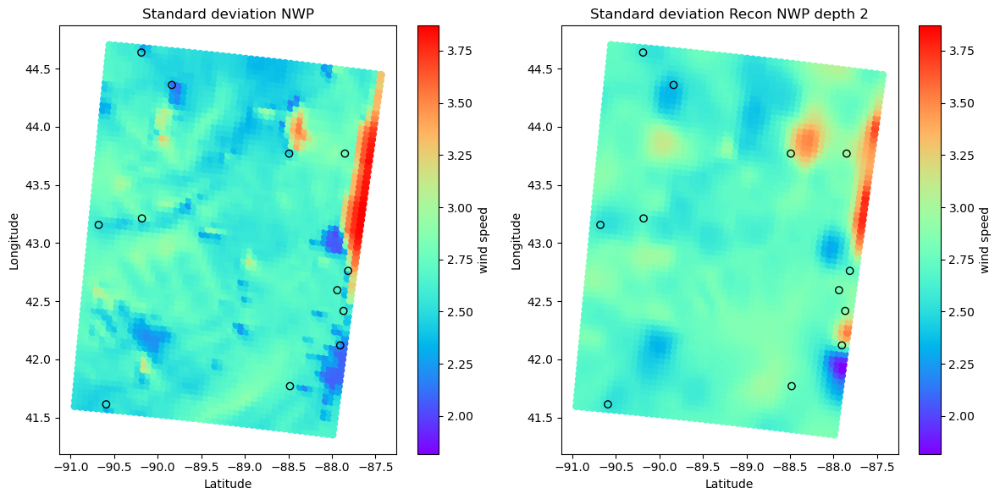

12
Test input shape nwp grid: torch.Size([153272, 1875])
Test output shape nwp grid: torch.Size([153272, 15])
Training on OBS lat long and sig PCA: (552, 1875)
Shape of reconstructed NWP : (46, 15, 3332)
Shape of reconstructed NWP at obs locations: (552, 15)
Correction output: (552, 15)
nwpobsgrid shape: torch.Size([46, 15, 12])
NWP stacked shape: (552, 15)
NWP stacked tensor shape: torch.Size([552, 15])
Input shape: torch.Size([552, 1875])
Output shape : torch.Size([552, 15])
Epoch [100/5000], Loss: 2.3636
Epoch [200/5000], Loss: 1.8241
Epoch [300/5000], Loss: 1.4190
Epoch [400/5000], Loss: 1.5523
Epoch [500/5000], Loss: 1.5158
Epoch [600/5000], Loss: 1.5195
Epoch [700/5000], Loss: 0.8238
Epoch [800/5000], Loss: 0.6319
Epoch [900/5000], Loss: 2.0750
Epoch [1000/5000], Loss: 1.0837
Epoch [1100/5000], Loss: 0.7785
Epoch [1200/5000], Loss: 1.3605
Epoch [1300/5000], Loss: 1.0864
Epoch [1400/5000], Loss: 1.2372
Epoch [1500/5000], Loss: 0.9460
Epoch [1600/5000], Loss: 1.1642
Epoch [1700/500

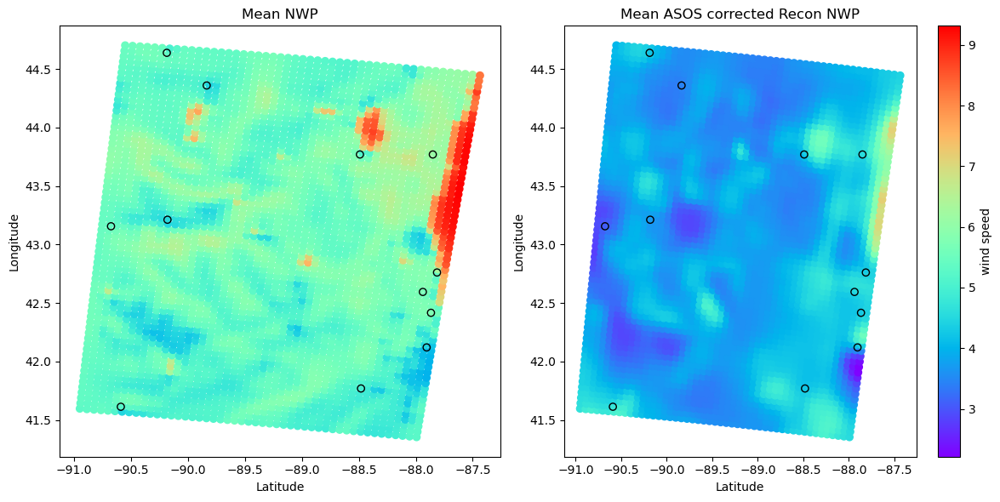

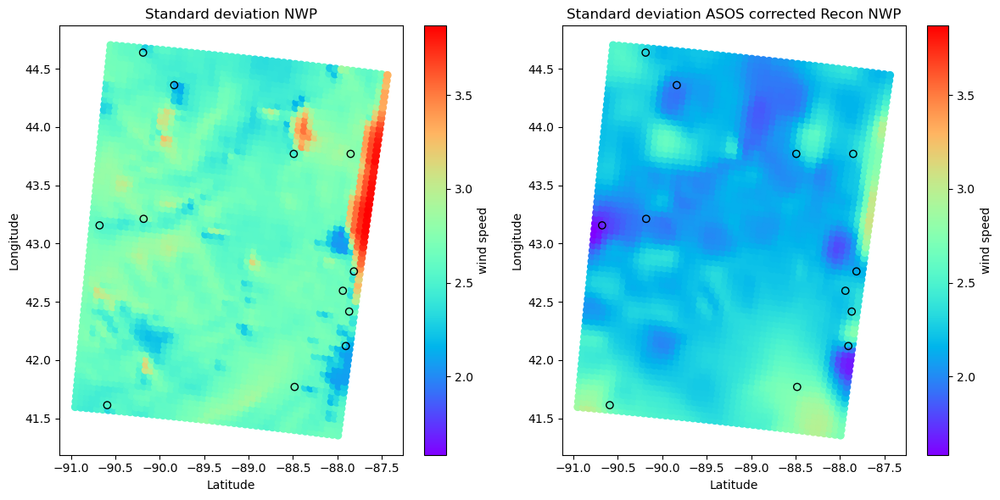

In [91]:
# Instantiate the ComputeWindowSignature class
compute_signature = pathsig.ComputeWindowSignature(
    window_name='Dyadic',          # The windowing method to use
    window_kwargs={'depth': 2},    # Parameters for the windowing method
    ds_length=final_transformed_ts.shape[1] ,                 # Length of the dataset
    sig_tfm='signature',           # Use signature transformation
    depth=2,                       # Signature depth
    rescaling=None,                # Rescaling method
    normalisation=None             # Normalisation method
)

#see the windows in detail
dyadic_window_instance = pathsig.window_getter('Dyadic', depth=2)
length =final_transformed_ts.shape[1] 
windows = dyadic_window_instance(length)
print(windows)
numwin= compute_signature.num_windows(final_transformed_ts.shape[1])
print(f"Total windows : {numwin}")

# Prepare the input path tensor
path = final_transformed_ts
signatures = compute_signature.forward(path)

# Print the signatures
print(f"Total signatures: len(signatures) ")

flattened_signatures = [signature for group in signatures for signature in group]
print(len(flattened_signatures))
# this is a list of length 7 corresponding to 7 windows,
#each element in the list has signature shape [46,3333]

stacked_signatures = torch.cat(flattened_signatures, dim=1)
print(stacked_signatures.shape)# concatenating all 7 signatures for all windows, first global, then half, then ...

smodule=signatory.signature_module
# Convert PyTorch tensor to NumPy for use with scikit-learn
flattened_signatures = [signature for group in signatures for signature in group]
columnwise_signatures = torch.cat(flattened_signatures, dim=1)
columnwise_signatures_np = columnwise_signatures.detach().cpu().numpy()
print(f'columnwise signatures: {columnwise_signatures_np.shape}')

stacked_signatures_np = stacked_signatures.detach().cpu().numpy()
print(f'Stacked signatures in numpy: {stacked_signatures_np.shape}')

scaler = StandardScaler()
signatures_np = scaler.fit_transform(stacked_signatures_np)

# Apply PCA to reduce dimensionality
pca = PCA()
pca.fit(signatures_np)
signatures_pca = pca.transform(signatures_np)
explained_variance = pca.explained_variance_ratio_
cumulative_explained_variance = explained_variance.cumsum()

num_components_95 =  next(i for i, total in enumerate(cumulative_explained_variance) if total > 0.995)+1

print(f"Number of components : {num_components_95}")
reduced_space= signatures_pca[:,:num_components_95]
print(f'PCA Reduced space: {reduced_space.shape}')


# Plot variance explained vs. number of components
plt.figure(figsize=(10, 6))
plt.plot(np.arange(1, len(explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='-')
plt.xlabel("Number of Principal Components", fontsize=14)
plt.ylabel("Cumulative Explained Variance", fontsize=14)
plt.title("PCA: Number of Components vs. Explained Variance", fontsize=16)
plt.grid()
plt.show()

components = pca.components_
unique_interaction_terms = set()

for i, component in enumerate(components):
    most_contributing_feature =np.argmax(np.abs(component))  # Get index of the highest absolute value
    win= most_contributing_feature // signatures[0][0].shape[1]
    col_within_window = most_contributing_feature % signatures[0][0].shape[1]

    depth, interaction_term = pathsig.map_column_to_interaction(col_within_window, channels=3332, max_depth=2)
    unique_interaction_terms.add(interaction_term)

    print(f"Principal Component {i+1}: Feature {most_contributing_feature} is the most important Depth {depth}, window {win}, Interaction Term: {interaction_term}")

# Print unique interaction terms
print("\nUnique Interaction Terms:")
for term in unique_interaction_terms:
    print(term)


# Use a set to find unique values
unique_values = set()

# Iterate through the list and add values to the set
for term in unique_interaction_terms:
    unique_values.update(term)

# Convert the set back to a sorted list for better readability
unique_values = sorted(unique_values)

# Print the unique values
print("Unique Values:", unique_values)
print(len(unique_values))

# Initialize an empty list to store the sigpca values
sigpca_values = []

# Loop over each index in label_indices
for i in label_indices:
    # Compute or access the sigpca value for the current index
    sigpca = unique_values[i]  # Assuming unique_values[i] is the value you want
    sigpca_values.append(sigpca)


# Calculate the number of rows and columns for the subplots
depth = 3
num_depths = len(windows[0:depth])  # Number of depth levels
max_sub_windows = max(len(window_list) for window_list in windows[0:depth])  # Maximum number of sub-windows at any depth

# Create a figure with appropriate size
fig, axes = plt.subplots(num_depths, max_sub_windows, figsize=(100, 80), squeeze=False)

# Initialize subplot counter
sub_window_counter = 0

# Store labels for a shared legend
labels = [f'Sig-PCA Loc {i +1}' for i in range(len(label_indices))]  # Assuming at most 10 signature columns
#labels = [f'Sig-PCA Loc {i +1}' for i in range(len(unique_values))]  # Assuming at most 10 signature columns

# Initialize an empty dictionary to store the fluctuations for each location
fluctuations = {}

# Loop over each depth and its sub-windows
for depth_idx, window_list in enumerate(windows[0:depth]):
    print(f"Processing hierarchical dyadic window depth {depth_idx + 1} with {len(window_list)} sub-windows")
    
    for sub_window_idx, pair in enumerate(window_list):
        # Extract the start and end indices of the current sub-window
        start_idx, end_idx = pair.start, pair.end
        print(f"Sub-window {sub_window_idx + 1} : Start = {start_idx}, End = {end_idx}")

        # Extract the corresponding signature for the current window and sub-window (assuming signature is a PyTorch tensor)
        signature = signatures[depth_idx][sub_window_idx]

        # Calculate fluctuations for each location (standard deviation of signature terms)
        for i in sigpca_values:  # Ensure we don't exceed the number of columns in signature
            loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
            if i not in fluctuations:
                fluctuations[i] = []
            fluctuations[i].append(loc_fluctuation)

        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     loc_fluctuation = signature[:, i].std().item()  # Standard deviation as the fluctuation measure
        #     if i not in fluctuations:
        #         fluctuations[i] = []
        #     fluctuations[i].append(loc_fluctuation)


        # Plot the first 100 terms of the signature for this sub-window
        ax = axes[depth_idx, sub_window_idx]  # Get the corresponding subplot
        for i in sigpca_values:  # Ensure we don't exceed the number of columns in signature
            # Convert x-axis indices to time in hours, then to days
            num_rows=signature.shape[0]
            x_hours = np.arange(num_rows) * 15  # Each row represents 15 hours
            x_days = x_hours / 24  # Convert hours to days
            
            # Plot the first column of signature (or any specific column)
            ax.plot(x_days, signature[:, i].numpy())  # Plotting against days
            
            # Adjust x-axis ticks
            


            #ax.plot(signature[:, i])  # Convert to NumPy for plotting
        # for i in unique_values:  # Ensure we don't exceed the number of columns in signature
        #     ax.plot(signature[:, i].numpy())  # Convert to NumPy for plotting

    
        # Set title and labels with increased font sizes
        ax.set_xticks(np.arange(0, np.max(x_days) + 1, 5))  # Set major ticks at every 1 day
        ax.set_title(f'Sub-window {sub_window_idx + 1}\nHourly Steps {start_idx}-{end_idx}', fontsize=100)
        ax.set_xlabel('Days', fontsize=100)
        ax.set_ylabel('Signature Value', fontsize=100)

        # Increase tick label font size
        ax.tick_params(axis='both', which='major', labelsize=100)

# Remove empty subplots if there are any
for depth_idx in range(num_depths):
    for sub_window_idx in range(len(windows[depth_idx]), max_sub_windows):
        fig.delaxes(axes[depth_idx, sub_window_idx])

# Add a shared legend for the figure with increased font size
fig.legend(labels, loc='center right', fontsize=100, title="Signature Terms", title_fontsize=100, bbox_to_anchor=(0.9, 0.5))

# Adjust layout to avoid overlapping subplots
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space on the right for the legend
#plt.savefig("nwpdepth2.pdf")
plt.show()

# Print the fluctuations for each location
for loc, fluct in fluctuations.items():
    print(f"Location {loc} fluctuations: {fluct}")

# Define the subwindow labels
subwindow_labels = ['0-16 hr', '0-8 hr', '8-16 hr', '0-4 hr', '4-8 hr', '8-12 hr', '12-16 hr']

# Create the plot
plt.figure(figsize=(10, 6))

# Loop through each location's fluctuations and plot
for i, (loc, fluct) in enumerate(fluctuations.items(), start=1):
    plt.plot(range(1, 8), fluct,marker='x',markersize=20, linestyle='', label=f'Sig-PCA Loc {i}')


# Customize the plot
plt.title("Fluctuations (Standard Deviations) Across Locations and Subwindows", fontsize=18)
plt.xlabel("Subwindows", fontsize=18)
plt.ylabel("Fluctuation (Standard Deviation)", fontsize=18)
plt.xticks(range(1, 8), subwindow_labels, fontsize=18)
plt.yticks(fontsize=18)
plt.legend(loc="upper right", fontsize=18)
plt.grid(True)
plt.savefig("nwpdepth2fluctuations.pdf")
plt.show()

lon_sigpca_1=long_flat[unique_values]
lat_sigpca_1=lat_flat[unique_values]

# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")


# Training--# Define sample sizes
percent = 4
total_size = 3332
sample_size = round((percent / 100) * total_size)

mse_results = []
length=46
num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

# Randomly select a subset of lat/lon points
np.random.seed(4)
indices = np.random.choice(len(lat_flat), sample_size, replace=False)
lat_subset = lat_flat[indices]
long_subset = long_flat[indices]

llong=np.array(long_subset)
llat= np.array(lat_subset)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_subset), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)

# Prepare input data
augmented_cols = []
for i in range(sample_size):
    lat_lon_column = np.column_stack((np.full(length, lat_subset[i]), np.full(length, long_subset[i])))
    basis_column = np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((reduced_space, lat_lon_column, basis_column))
    augmented_cols.append(augmented_chunk)

input_subset = np.vstack(augmented_cols)
target_subset = np.vstack([nwp_tensor[:, :, i] for i in indices])

# Convert to PyTorch tensors
inputs_tensor = torch.tensor(input_subset, dtype=torch.float32)
targets_tensor = torch.tensor(target_subset, dtype=torch.float32)
print(f'Input shape: {inputs_tensor.shape}')
print(f'Output NWP at fixed grid shape: {targets_tensor.shape}')

# Train the neural network
model = nnmodule.SimpleNNpos(input_subset.shape[1], target_subset.shape[1])
optimizer = optim.Adam(model.parameters(), lr=0.01)
criterion = nn.MSELoss()

num_epochs = 5000  # Reduce training iterations for efficiency
for epoch in range(num_epochs):
    optimizer.zero_grad()
    outputs = model(inputs_tensor)
    loss = criterion(outputs, targets_tensor)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

# Evaluate model
with torch.no_grad():
    predictions_val = model(testinput_tensor)
mse = F.mse_loss(predictions_val, testtarget_tensor).item()
print(f"Sample size: {sample_size},  MSE between reconstructed NWP and true NWP entire grid: {mse:.4f}")

nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])

obstestgrid = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))
for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = flattened_trimmed_nwp[i, :]
    flattened_series_nwp = blocknwp.flatten()

    blockpredsgrid = predictions_val[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()
    obstestgrid[i, :] = flattened_series_predsgrid
print(obstestgrid.shape)

sigpca_dk_nwp_4percent_depth2=obstestgrid

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid, axis=1)
variance_values_obs = np.std(obstestgrid, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# Plot the mean heatmap using scatter
plt.figure(figsize=(12, 6))  
plt.subplot(1, 2, 1)
sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean NWP')

plt.subplot(1, 2, 2)
sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc2,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Mean Recon NWP depth 2')

plt.tight_layout()
plt.show()


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc3,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation NWP')

plt.subplot(1, 2, 2)
sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
plt.colorbar(sc4,label='wind speed')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Standard deviation Recon NWP depth 2')
plt.tight_layout()
plt.show()

closest_lats = []
closest_lons = []
closest_indices = []
for latc, lonc in zip(lat_obs, lon_obs):
    # Calculate the distance to each station in lat_flat and long_flat
    distances = np.sqrt((lat_flat - latc)**2 + (long_flat - lonc)**2)
    closest_index = np.argmin(distances)  # Find the index of the minimum distance
    
    # Append the closest latitude, longitude, and index
    closest_lats.append(lat_flat [closest_index])
    closest_lons.append(long_flat[closest_index])
    closest_indices.append(closest_index)

# Convert to numpy arrays for easy handling
closest_lats = np.array(closest_lats)
closest_lons = np.array(closest_lons)
closest_indices = np.array(closest_indices)
print(len(closest_indices))

# Test input
length=46

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

## Romove the all-zero columns
idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)


# Create augmented input
augmented_cols = []

for i in range(len(lat_flat)):
    chunk = reduced_space
    
    # Create an array of shape (length, 2) with lat_obs[i] and lon_obs[i]
    lat_lon_column = np.column_stack((np.full(length, lat_flat[i]), np.full(length, long_flat[i])))
    basiscolumn= np.tile(phigrid[i, :], (length, 1))
    # Concatenate the chunk with the lat/lon columns and the basis functions
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    
    # Append to the list of augmented rows
    augmented_cols.append(augmented_chunk)

# Combine all augmented rows back into one array
testinput = np.vstack(augmented_cols)
testinput_tensor = torch.tensor(testinput, dtype=torch.float32)
print(f"Test input shape nwp grid: {testinput_tensor.shape}")

testtarget_subset = np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
testtarget_tensor = torch.tensor(testtarget_subset, dtype=torch.float32)
print(f"Test output shape nwp grid: {testtarget_tensor.shape}")

num_basis = [10**2,19**2,37**2]
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]

llong=np.array(lon_obs)
llat= np.array(lat_obs)

normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))

##Wendland kernel
basis_size = 0
phi = np.zeros((len(lat_obs), sum(num_basis)))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phi[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phi[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phi.shape[1]):
    if sum(phi[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phi_reduce = np.delete(phi,idx_zero,1)


num_basis = [10**2,19**2,37**2]

phigrid = np.zeros((len(lat_flat), sum(num_basis)))
llong=np.array(long_flat)
llat= np.array(lat_flat)
knots_1dx = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
knots_1dy = [np.linspace(0,1,int(np.sqrt(i))) for i in num_basis]
basis_size=0
normalized_lon = (llong-min(llong))/(max(llong)-min(llong))
normalized_lat = (llat-min(llat))/(max(llat)-min(llat))
for res in range(len(num_basis)):
    theta = 1/np.sqrt(num_basis[res])*2.5
    knots_x, knots_y = np.meshgrid(knots_1dx[res],knots_1dy[res])
    knots = np.column_stack((knots_x.flatten(),knots_y.flatten()))
    for i in range(num_basis[res]):
        d = np.linalg.norm(np.vstack((normalized_lon,normalized_lat)).T-knots[i,:],axis=1)/theta
        for j in range(len(d)):
            if d[j] >= 0 and d[j] <= 1:
                phigrid[j,i + basis_size] = (1-d[j])**6 * (35 * d[j]**2 + 18 * d[j] + 3)/3
            else:
                phigrid[j,i + basis_size] = 0
    basis_size = basis_size + num_basis[res]

idx_zero = np.array([], dtype=int)
for i in range(phigrid.shape[1]):
    if sum(phigrid[:,i]!=0)==0:
        idx_zero = np.append(idx_zero,int(i))
phigrid_reduce = np.delete(phigrid,idx_zero,1)

length=nwp_tensor.shape[0]
augmented_cols = []
for i in range(len(lat_obs)):
    chunk = reduced_space
    lat_lon_column = np.column_stack((np.full(length, lat_obs[i]), np.full(length, lon_obs[i])))
    basiscolumn= np.tile(phi[i, :], (length, 1))
    augmented_chunk = np.hstack((chunk, lat_lon_column,basiscolumn))
    augmented_cols.append(augmented_chunk)

input = np.vstack(augmented_cols)
print(f'Training on OBS lat long and sig PCA: {input.shape}')

recon_nwp_3332=np.zeros(nwp_tensor.shape)
for i in range(nwp_tensor.shape[2]):
    recon_nwp_3332[:, :, i] = torch.from_numpy(sigpca_dk_nwp_4percent_depth2[i, :].reshape(nwp_tensor.shape[0],nwp_tensor.shape[1])).float()
print(f'Shape of reconstructed NWP : {recon_nwp_3332.shape}')

recon_nwp_3332_closestin=np.vstack([recon_nwp_3332[:, :, i] for i in closest_indices])
print(f'Shape of reconstructed NWP at obs locations: {recon_nwp_3332_closestin.shape}')

# output is OBS-reconstructed NWP[ closest indices]
output= obsstack-recon_nwp_3332_closestin
print(f'Correction output: {output.shape}')

input_size = input.shape[1]
output_size = output.shape[1]


nwpobsgrid=nwp_tensor[:,:,closest_indices]
print(f'nwpobsgrid shape: {nwpobsgrid.shape}')
nwpstack=np.vstack([nwpobsgrid[:, :, i] for i in range(nwpobsgrid.shape[2])])
print(f"NWP stacked shape: {nwpstack.shape}") 
nwpstacktensor= torch.tensor(nwpstack, dtype=torch.float32)
print(f"NWP stacked tensor shape: {nwpstacktensor.shape}") 


model = nnmodule.SimpleNN(input_size,output_size)

optimizer = optim.Adam(model.parameters(), lr=0.01) #0.01 is good

inputs_tensor=torch.tensor(input, dtype=torch.float32)
print(f"Input shape: {inputs_tensor.shape}")
targets_tensor=torch.tensor(output, dtype=torch.float32)
print(f"Output shape : {targets_tensor.shape}")

num_epochs = 5000

for epoch in range(num_epochs):
    optimizer.zero_grad()  
    outputs = model(inputs_tensor) 
    loss = nnmodule.custom_loss(outputs, targets_tensor,nwpstacktensor)
    loss.backward()  
    optimizer.step()  
    if (epoch + 1) % 100 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')
        

with torch.no_grad(): 
    predictions = model(testinput_tensor) 

targets_np = targets_tensor.cpu().numpy() 
predictions_np = predictions.cpu().numpy() 


obstestgrid_recon = np.zeros((flattened_trimmed_nwp.shape[0], flattened_trimmed_nwp.shape[1]))

for i in range(flattened_trimmed_nwp.shape[0]):
    blocknwp = sigpca_dk_nwp_4percent_depth2[i, :]
    flattened_series_nwp_recon = blocknwp.flatten()

    blockpredsgrid = predictions_np[i*length:(i+1)*length, :]
    flattened_series_predsgrid = blockpredsgrid.flatten()

    obstestgrid_recon[i, :] = flattened_series_nwp_recon + flattened_series_predsgrid

print(obstestgrid_recon.shape)

sigpca_dk_grid_corr_4percent_depth2=obstestgrid_recon

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs = np.mean(obstestgrid_recon, axis=1)
variance_values_obs = np.std(obstestgrid_recon, axis=1)

vmin = min(mean_values.min(), mean_values_obs.min())
vmax = max(mean_values.max(), mean_values_obs.max())

vminva = min(variance_values.min(), variance_values_obs.min())
vmaxva = max(variance_values.max(), variance_values_obs.max())


# # Plot the mean heatmap using scatter
# plt.figure(figsize=(12, 6))  
# plt.subplot(1, 2, 1)
# sc1=plt.scatter(long_flat, lat_flat, c=mean_values, cmap='rainbow', vmin=vmin, vmax=vmax)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Mean NWP')

# plt.subplot(1, 2, 2)
# sc2=plt.scatter(long_flat, lat_flat, c=mean_values_obs, cmap='rainbow', vmin=vmin, vmax=vmax)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc2,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Mean ASOS corrected Recon NWP')

# plt.tight_layout()
# plt.show()


# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# sc3=plt.scatter(long_flat, lat_flat, c=variance_values, cmap='rainbow',vmin=vminva, vmax=vmaxva)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc3,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Standard deviation NWP')

# plt.subplot(1, 2, 2)
# sc4=plt.scatter(long_flat, lat_flat, c=variance_values_obs, cmap='rainbow',vmin=vminva, vmax=vmaxva)
# plt.scatter(lon_obs, lat_obs, facecolors='none', edgecolors='black',  marker='o', label='Observation Points')
# plt.colorbar(sc4,label='wind speed')
# plt.xlabel('Latitude')
# plt.ylabel('Longitude')
# plt.title('Standard deviation ASOS corrected Recon NWP')
# plt.tight_layout()
# plt.show()


In [39]:
# np.save("sigpca_dk_nwp_4percent_depth2.npy", sigpca_dk_nwp_4percent_depth2)
# np.save("sigpca_dk_grid_corr_4percent_depth2.npy", sigpca_dk_grid_corr_4percent_depth2)

sigpca_dk_nwp_4percent_depth2= np.load(  "sigpca_dk_nwp_4percent_depth2.npy")
sigpca_dk_grid_corr_4percent_depth2 = np.load("sigpca_dk_grid_corr_4percent_depth2.npy")

# plot comparisons

/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_70735/3508638415.py:129: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0, 0])  # Adjust space for colorbar and legend
/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_70735/3508638415.py:129: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 0, 0, 0])  # Adjust space for colorbar and legend


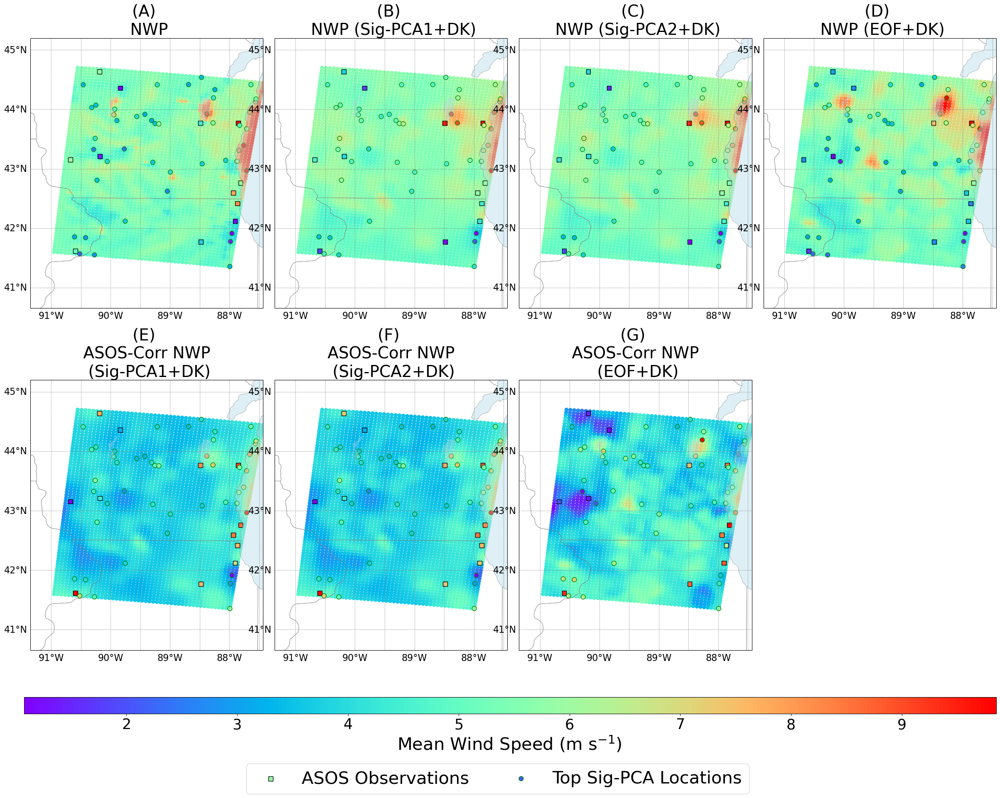

/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_70735/3508638415.py:189: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0,0,0])  # Adjust space for colorbar and legend
/var/folders/b5/7ttzcvrn2mngkw42xq19k9m1cmzbbx/T/ipykernel_70735/3508638415.py:189: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 0,0,0])  # Adjust space for colorbar and legend


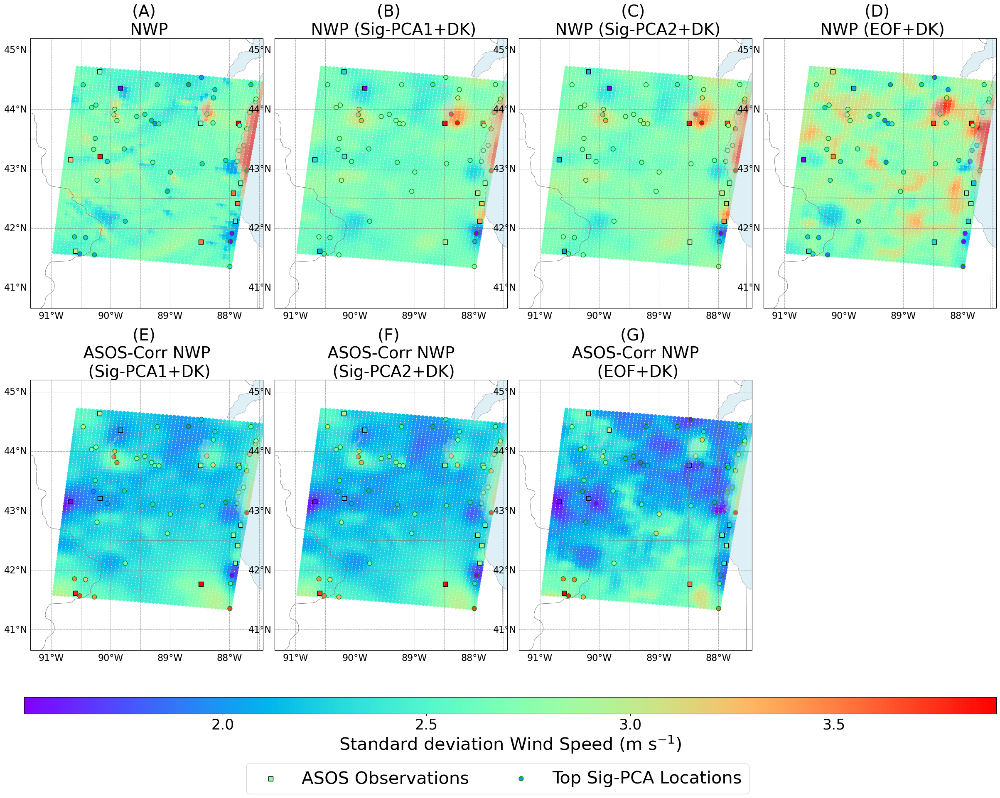

In [60]:
latdepth1=lat_flat[unique_values]
londepth1=long_flat[unique_values]

mean_values = np.mean(flattened_trimmed_nwp, axis=1)
variance_values = np.std(flattened_trimmed_nwp, axis=1)

mean_values_obs_sigpca1 = np.mean(sigpca_dk_nwp_4percent, axis=1)
variance_values_obs_sigpca1 = np.std(sigpca_dk_nwp_4percent, axis=1)

mean_values_obs_sigpca1_dk = np.mean(sigpca_dk_grid_corr_4percent, axis=1)
variance_values_obs_sigpca1_dk = np.std(sigpca_dk_grid_corr_4percent, axis=1)



mean_values_obs_sigpca2_dk = np.mean(sigpca_dk_grid_corr_4percent_depth2, axis=1)
variance_values_obs_sigpca2_dk = np.std(sigpca_dk_grid_corr_4percent_depth2, axis=1)

mean_values_obs_sigpca2 = np.mean(sigpca_dk_nwp_4percent_depth2, axis=1)
variance_values_obs_sigpca2 = np.std(sigpca_dk_nwp_4percent_depth2, axis=1)

mean_values_eof_dk= np.mean(eof_dk_nwp_4percent, axis=1)
variance_values_eof_dk = np.std(eof_dk_nwp_4percent, axis=1)

mean_values_obs_eof_dk = np.mean(eof_dk_grid_corr_4percent, axis=1)
variance_values_obs_eof_dk = np.std(eof_dk_grid_corr_4percent, axis=1)

vmin = min(mean_values.min(),mean_values_obs_sigpca1.min(),mean_values_obs_sigpca1_dk.min(),mean_values_eof_dk.min(), mean_values_obs_eof_dk.min(), mean_values_obs_sigpca2.min(), mean_values_obs_sigpca2_dk.min())
          
vmax = max(mean_values.max(),mean_values_obs_sigpca1.max(),mean_values_obs_sigpca1_dk.max(),mean_values_eof_dk.max(), mean_values_obs_eof_dk.max(), mean_values_obs_sigpca2.max(), mean_values_obs_sigpca2_dk.max())
          

vminva = min(variance_values.min(),variance_values_obs_sigpca1.min(),variance_values_obs_sigpca1_dk.min(),variance_values_eof_dk.min(),  variance_values_obs_eof_dk.min(),variance_values_obs_sigpca2_dk.min(),variance_values_obs_sigpca2.min())
vmaxva = max(variance_values.max(),variance_values_obs_sigpca1.max(), variance_values_obs_sigpca1_dk.max(),variance_values_eof_dk.max(), variance_values_obs_eof_dk.max(),variance_values_obs_sigpca2_dk.max(),variance_values_obs_sigpca2.max())


nearest_indices_obs = []

for lat_o, lon_o in zip(lat_obs, lon_obs):
    distances = np.sqrt((lat_flat - lat_o) ** 2 + (long_flat - lon_o) ** 2)
    
    nearest_index = np.argmin(distances)
    nearest_indices_obs.append(nearest_index)

# Function to create each subplot
def plot_subplot(ax, lon_min, lon_max, lat_min, lat_max, lon_points_wi, lat_points_wi, 
                 data_values, longitudes_obs, latitudes_obs, data_values_obs, data_values_depth1,
                 cmap, vmin, vmax, title, show_legend=False):

    ax.add_feature(cfeature.BORDERS, linestyle=':', linewidth=1, edgecolor='black')
    ax.add_feature(cfeature.STATES, edgecolor='gray', linewidth=0.5)
    ax.add_feature(cfeature.LAKES, facecolor='lightblue', alpha=0.4)  # Lakes with transparency

    # Scatter plots
    sc = ax.scatter(lon_points_wi, lat_points_wi, c=data_values, cmap=cmap, vmin=vmin, vmax=vmax, 
                    transform=ccrs.PlateCarree())
    obs_scatter = ax.scatter(longitudes_obs, latitudes_obs, c=data_values_obs, cmap=cmap, edgecolors='black', 
                              marker='s', s=60, label='ASOS Observations', transform=ccrs.PlateCarree())
    depth_scatter = ax.scatter(londepth1, latdepth1, c=data_values_depth1, cmap=cmap, edgecolors='green', 
                                marker='o', s=60, label='Top Sig-PCA Locations', transform=ccrs.PlateCarree())

    # Add a grid for better readability
    gridlines = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', linestyle='--')
    gridlines.top_labels = False
    gridlines.right_labels = False
    
    # Increase axis label font size
    gridlines.xlabel_style = {'size': 16}  # X-axis label font size
    gridlines.ylabel_style = {'size': 16}  # Y-axis label font size
    ax.tick_params(axis='both', which='major', labelsize=16)  # Increase tick label font size

    # Zoom into the region of interest
    ax.set_extent([lon_min-0.4, lon_max, lat_min-0.7, lat_max+0.5], crs=ccrs.PlateCarree())

    # Customize the axes
    ax.set_title(title, fontsize=28)
    
    return sc, obs_scatter, depth_scatter

# Create figure and subplots with 1 row and 3 columns
fig, axes = plt.subplots(2,4, figsize=(30,20), subplot_kw={'projection': ccrs.PlateCarree()})

# Define dataset mappings for the subplots
datasets = [
    (mean_values, '(A) \n NWP'),
    (mean_values_obs_sigpca1, '(B) \n NWP (Sig-PCA1+DK)'),
    (mean_values_obs_sigpca2, '(C) \n NWP (Sig-PCA2+DK)'),
    (mean_values_eof_dk, '(D) \n NWP (EOF+DK)'),
    (mean_values_obs_sigpca1_dk, '(E) \n ASOS-Corr NWP \n (Sig-PCA1+DK)'),
    (mean_values_obs_sigpca2_dk, '(F) \n ASOS-Corr NWP \n (Sig-PCA2+DK)'),
    (mean_values_obs_eof_dk, '(G) \n ASOS-Corr NWP \n (EOF+DK)')
]

# Loop through datasets and create subplots
sc_list = []
legend_handles = None  # Store legend handles

for i, (data_values, title) in enumerate(datasets):
    ax = axes.flat[i]  # Use `flat[i]` to correctly index 2D axes array

    data_values_obs = data_values[nearest_indices_obs]
    data_values_depth1 = data_values[unique_values]
    
    sc, obs_scatter, depth_scatter = plot_subplot(
        ax, lon_min, lon_max, lat_min, lat_max, 
        long_flat, lat_flat, data_values, lon_obs, lat_obs, data_values_obs, data_values_depth1, 
        'rainbow', vmin, vmax, title
    )
    
    sc_list.append(sc)
    if legend_handles is None:
        legend_handles = [obs_scatter, depth_scatter]  # Store legend handles
fig.delaxes(axes.flat[-1])  # Remove empty subplot if not used
#fig.delaxes(axes.flat[-2])  # Remove empty subplot if not used


# Add a shared colorbar at the bottom
cbar_ax = fig.add_axes([0.12, 0.05, 0.78, 0.02])  # Adjust position and size
cbar = fig.colorbar(sc_list[0], cax=cbar_ax, orientation='horizontal', label='Mean Wind Speed (m s$^{-1}$) ')
cbar.ax.xaxis.label.set_fontsize(30)  # Increase label font size
cbar.ax.tick_params(labelsize=25)  # Increase tick font size

# Reduce gaps between subplots
plt.subplots_adjust(hspace=0.15, wspace=0.05)  # Adjust spacing between subplots

# Place legend below the colorbar, without too much white space
fig.legend(handles=legend_handles, loc='upper center', fontsize=30, bbox_to_anchor=(0.5, -0.01), borderaxespad=0., ncol=3)

# Adjust layout for readability, make room for colorbar and legend
plt.tight_layout(rect=[0, 0, 0, 0])  # Adjust space for colorbar and legend

# Save the plot
plt.savefig("reconnwp_meancomparison.pdf", dpi=300, bbox_inches="tight", pad_inches=0.2)

plt.show()



# Create figure and subplots with 1 row and 3 columns
fig, axes = plt.subplots(2,4, figsize=(30,20), subplot_kw={'projection': ccrs.PlateCarree()})

# Define dataset mappings for the subplots
datasets = [
    (variance_values, '(A) \n NWP'),
    (variance_values_obs_sigpca1, '(B) \n NWP (Sig-PCA1+DK)'),
    (variance_values_obs_sigpca2, '(C) \n NWP (Sig-PCA2+DK)'),
    (variance_values_eof_dk, '(D) \n NWP (EOF+DK)'),

    (variance_values_obs_sigpca1_dk, '(E) \n ASOS-Corr NWP \n (Sig-PCA1+DK)'),
    (variance_values_obs_sigpca2_dk, '(F) \n ASOS-Corr NWP \n (Sig-PCA2+DK)'),
    (variance_values_obs_eof_dk, '(G) \n ASOS-Corr NWP \n (EOF+DK)')

]

# Loop through datasets and create subplots
sc_list = []
legend_handles = None  # Store legend handles

for i, (data_values, title) in enumerate(datasets):
    ax = axes.flat[i]  # Use `flat[i]` to correctly index 2D axes array

    data_values_obs = data_values[nearest_indices_obs]
    data_values_depth1 = data_values[unique_values]
    
    sc, obs_scatter, depth_scatter = plot_subplot(
        ax, lon_min, lon_max, lat_min, lat_max, 
        long_flat, lat_flat, data_values, lon_obs, lat_obs, data_values_obs, data_values_depth1, 
        'rainbow', vminva, vmaxva, title
    )
    
    sc_list.append(sc)
    if legend_handles is None:
        legend_handles = [obs_scatter, depth_scatter]  # Store legend handles
fig.delaxes(axes.flat[-1])  # Remove empty subplot if not used
#fig.delaxes(axes.flat[-2])  # Remove empty subplot if not used

# Add a shared colorbar at the bottom
cbar_ax = fig.add_axes([0.12, 0.05, 0.78, 0.02])  # Adjust position and size
cbar = fig.colorbar(sc_list[0], cax=cbar_ax, orientation='horizontal', label='Standard deviation Wind Speed (m s$^{-1}$)')
cbar.ax.xaxis.label.set_fontsize(30)  # Increase label font size
cbar.ax.tick_params(labelsize=25)  # Increase tick font size

# Reduce gaps between subplots
plt.subplots_adjust(hspace=0.15, wspace=0.05)  # Adjust spacing between subplots

# Place legend below the colorbar, without too much white space
fig.legend(handles=legend_handles, loc='upper center', fontsize=30, bbox_to_anchor=(0.5, -0.01), borderaxespad=0., ncol=3)

# Adjust layout for readability, make room for colorbar and legend
plt.tight_layout(rect=[0, 0,0,0])  # Adjust space for colorbar and legend

# Save the plot
plt.savefig("reconnwp_stdcomparison.pdf", dpi=300, bbox_inches="tight", pad_inches=0.2)

plt.show()



# Plot time series

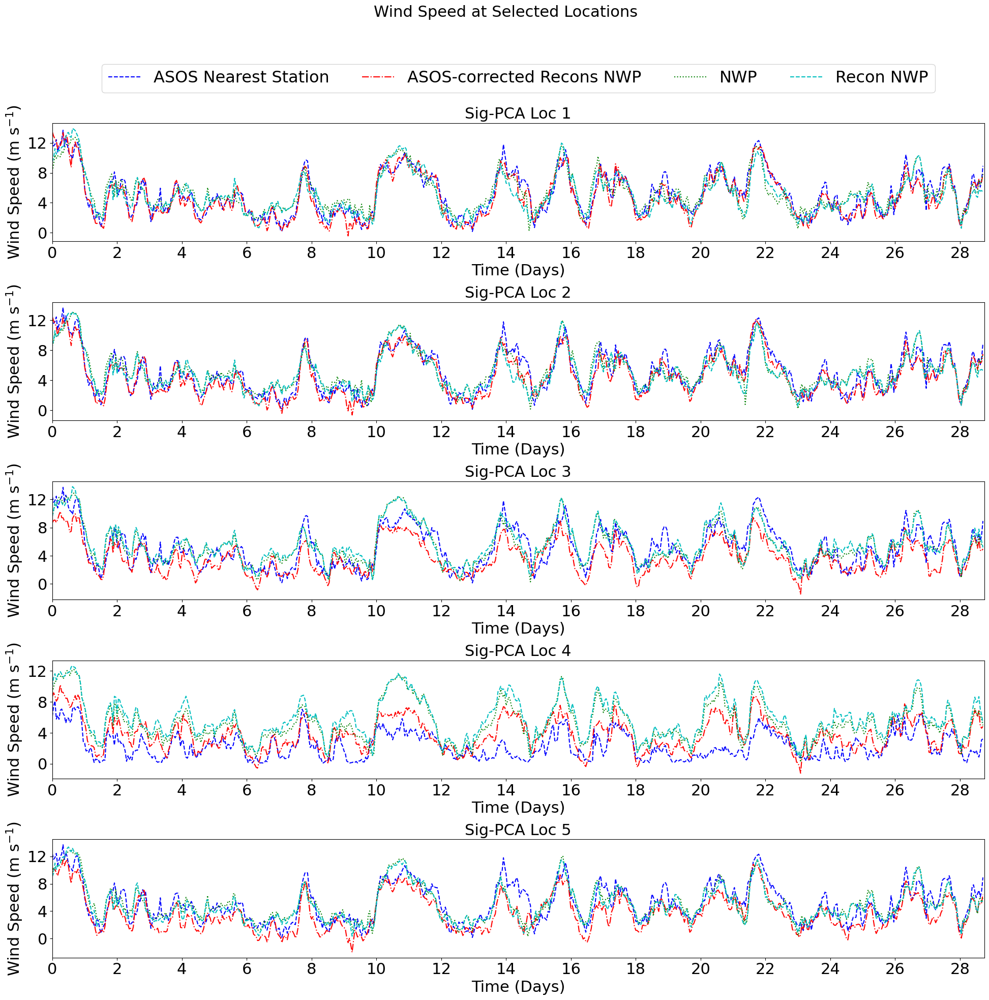

In [103]:
nwpgrid=np.vstack([nwp_tensor[:, :, i] for i in range(nwp_tensor.shape[2])])
obsstack=np.vstack([obs_tensor[:, :, i] for i in range(obs_tensor.shape[2])])

selected_lons = [long_flat[i] for i in sigpca_values]
selected_lats = [lat_flat[i] for i in sigpca_values]

fig, axs = plt.subplots(5, 1, figsize=(20, 20))  # Create a single figure with 5 subplots
fig.suptitle("Wind Speed at Selected Locations", fontsize=22)  

for idx, (lat, lon) in enumerate(zip(selected_lats, selected_lons)):
    if idx >= 5:  # Only plot the first 5 locations
        break

    # Find the nearest observation index and grid index
    obs_idx = np.argmin((lat_obs - lat)**2 + (lon_obs - lon)**2)
    loc_idx = sigpca_values[idx]

    length = nwp_tensor.shape[0]
    flattened_series_nwp_orig = nwpgrid[loc_idx * length : (loc_idx + 1) * length, :].flatten()
    flattened_series_obs_nearest = obsstack[obs_idx * length : (obs_idx + 1) * length, :].flatten()
    flattened_series_recon_nwp_sigpcadk = sigpca_dk_nwp_4percent[loc_idx, :].flatten()
    flattened_series_recon_asos_sigpcadk = sigpca_dk_grid_corr_4percent[loc_idx, :].flatten()

    colors = ['b', 'r', 'g', 'm', 'c']
    linestyles = ['--', '-.', ':', '-', '--']
    
    axs[idx].plot(flattened_series_obs_nearest, label="ASOS Nearest Station", 
                  color=colors[0], linestyle=linestyles[0])
    axs[idx].plot(flattened_series_recon_asos_sigpcadk, label="ASOS-corrected Recons NWP", 
                  color=colors[1], linestyle=linestyles[1])
    axs[idx].plot(flattened_series_nwp_orig, label="NWP", 
                  color=colors[2], linestyle=linestyles[2])
    axs[idx].plot(flattened_series_recon_nwp_sigpcadk, label="Recon NWP", 
                  color=colors[4], linestyle=linestyles[4])

    xtick_positions = np.arange(0, len(flattened_series_obs_nearest), 48)
    xtick_labels = [f"{i}" for i in range(0, len(xtick_positions) * 2, 2)]

    axs[idx].set_xticks(xtick_positions)
    axs[idx].set_xticklabels(xtick_labels, fontsize=22)
    axs[idx].set_xlim(0, len(flattened_series_obs_nearest))
    axs[idx].set_xlabel("Time (Days)", fontsize=22)
    axs[idx].set_ylabel("Wind Speed (m s$^{-1}$)", fontsize=22)
    axs[idx].tick_params(axis='y', labelsize=22)

# Adjust y-ticks to show a reasonable range, automatically determined
    axs[idx].yaxis.set_major_locator(plt.MaxNLocator(nbins=5))  # Adjust the number of ticks as needed


    #axs[0].legend(fontsize=23, loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
    axs[0].legend(fontsize=23, loc='upper center', bbox_to_anchor=(0.5, 1.5), ncol=5, borderaxespad=0.)
    axs[idx].set_title(f"Sig-PCA Loc {idx + 1}", fontsize=22)


plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.savefig("wind_speed_subplots.pdf", dpi=300, bbox_inches="tight")
plt.show()


# spectral comparison

/opt/anaconda3/lib/python3.12/site-packages/scipy/signal/_spectral_py.py:790: UserWarning: nperseg = 1024 is greater than input length  = 690, using nperseg = 690
  freqs, _, Pxy = _spectral_helper(x, y, fs, window, nperseg, noverlap,


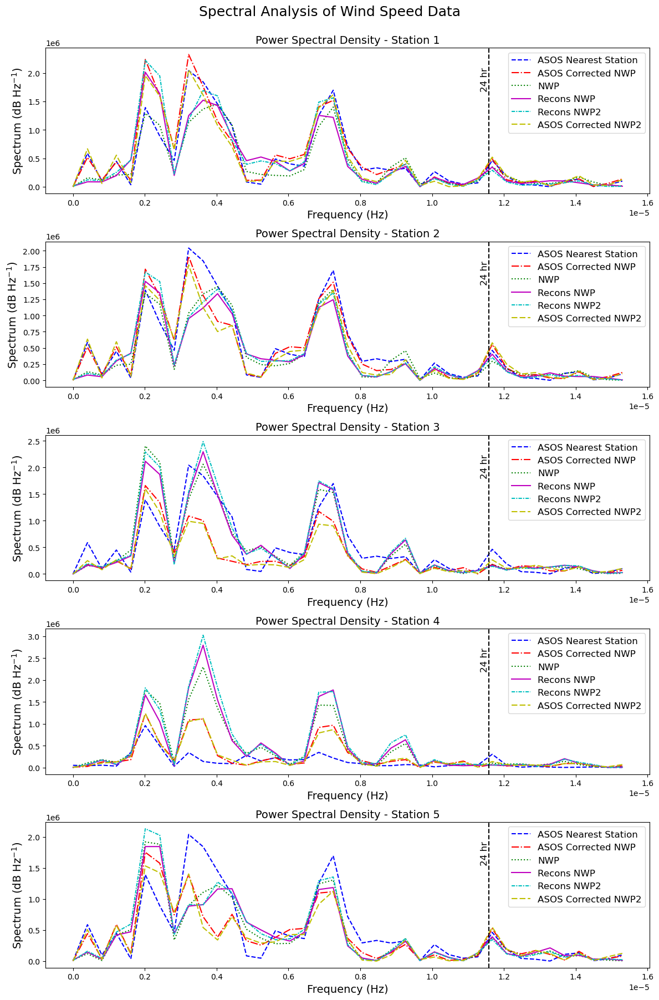

In [110]:
# Function to calculate and plot Power Spectral Density (PSD) using Welch's method
def plot_psd(ax, series, color, linestyle, label):
    f, Pxx = welch(series, fs=1/3600, nperseg=1024)  # 1 sample per hour
    mask = f <= 1/(18*3600)  # Limit to meaningful frequency range
    f_limit, Pxx_limit = f[mask], Pxx[mask]

    ax.plot(f_limit, Pxx_limit, color=color, linestyle=linestyle, label=label)
    ax.set_xlabel('Frequency (Hz)', fontsize=14)
    ax.set_ylabel('Spectrum (dB Hz$^{-1}$)', fontsize=14)
    ax.legend(fontsize=12)

colors = ['b', 'r', 'g', 'm', 'c', 'y']
linestyles = ['--', '-.', ':', '-', (0, (3, 1, 1, 1)), (0, (5, 2))]

# Select locations
selected_lons = [long_flat[i] for i in sigpca_values]
selected_lats = [lat_flat[i] for i in sigpca_values]

fig, axs = plt.subplots(5, 1, figsize=(12, 18))  # 5 stations, 1 column
fig.suptitle("Spectral Analysis of Wind Speed Data", fontsize=18, y=1)
plt.subplots_adjust(top=0.92)  # Adjust spacing between main title and subplots

for row_idx, (lat, lon) in enumerate(zip(selected_lats, selected_lons)):
    obs_idx = np.argmin((lat_obs - lat)**2 + (lon_obs - lon)**2)
    loc_idx = sigpca_values[row_idx]  
    length = nwp_tensor.shape[0]

    # Extract full time-series data (no seasonal slicing)
    flattened_series_nwp = nwpgrid[loc_idx * length : (loc_idx + 1) * length, :].flatten()
    flattened_series_obs_nearest = obsstack[obs_idx * length : (obs_idx + 1) * length, :].flatten()
    flattened_series_recon_nldas = sigpca_dk_nwp_4percent[loc_idx, :].flatten()
    flattened_series_recon_lcd = sigpca_dk_grid_corr_4percent[loc_idx, :].flatten()
    flattened_series_recon_nldas2 = sigpca_dk_nwp_4percent_depth2[loc_idx, :].flatten()
    flattened_series_recon_lcd2 = sigpca_dk_grid_corr_4percent_depth2[loc_idx, :].flatten()

    # Power Spectral Density (PSD) Plot
    plot_psd(axs[row_idx], flattened_series_obs_nearest, colors[0], linestyles[0], "ASOS Nearest Station")
    plot_psd(axs[row_idx], flattened_series_recon_lcd, colors[1], linestyles[1], "ASOS Corrected NWP")
    plot_psd(axs[row_idx], flattened_series_nwp, colors[2], linestyles[2], "NWP")
    plot_psd(axs[row_idx], flattened_series_recon_nldas, colors[3], linestyles[3], "Recons NWP")
    plot_psd(axs[row_idx], flattened_series_recon_nldas2, colors[4], linestyles[4], "Recons NWP2")
    plot_psd(axs[row_idx], flattened_series_recon_lcd2, colors[5], linestyles[5], "ASOS Corrected NWP2")


    # Adding vertical reference line for periodicities (24h)
    freq_24h = 1 / (24 * 3600)
    axs[row_idx].axvline(freq_24h, linestyle='--', color='black')
    axs[row_idx].text(freq_24h, axs[row_idx].get_ylim()[1] * 0.7, '24 hr', fontsize=12, horizontalalignment='right', rotation=90)

    axs[row_idx].set_title(f"Power Spectral Density - Station {row_idx + 1}", fontsize=14)

plt.tight_layout()
#plt.savefig("spectral_analysis.pdf", dpi=300, bbox_inches="tight")
plt.show()
